In [1]:
import pickle, rasterio, s3fs, requests, tempfile, zipfile
import holidays, pytz, mgzip, glob, os, lzma, blosc
#import xarray, zarr

import numpy as np
import pandas as pd

from time import sleep
from datetime import datetime, date, timedelta
from solarpy import irradiance_on_plane

from scipy.interpolate import griddata

import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import geopandas as gpd
from shapely.geometry import Point

# Define input paths 
path_to_data   = r"/Users/Guille/Desktop/caiso_power/data/"
path_to_temp   = r"/Users/Guille/Desktop/caiso_power/data/temp/"
path_to_images = r"/Users/Guille/Desktop/caiso_power/images/"

# Define output paths
path_to_oac = r"/Users/Guille/Desktop/caiso_power/output/actuals/"
path_to_ofc = r"/Users/Guille/Desktop/caiso_power/output/forecasts/"
path_to_oax = r"/Users/Guille/Desktop/caiso_power/output/auxiliary/"
path_to_odp = r"/Users/Guille/Desktop/caiso_power/output/processed_data/"

# California region
lon_min = -125
lon_max = -112
lat_min = 32
lat_max = 43

# Grid resolution in degrees
delta = .125

# Longitude left - right from meridiam
x_ = np.arange(lon_min, lon_max, delta)
# Latitude top - bottom from ecuator
y_ = np.arange(lat_min, lat_max, delta)

# Get Grid Dimensions
N = x_.shape[0]
M = y_.shape[0]
print(N, M)

104 88


# Generate Interpolation Grid

In [2]:
# Define the desired grid coordinates
X_, Y_ = np.meshgrid(x_, y_)
print(X_.shape, Y_.shape)
W_ref_ = np.concatenate((X_.flatten()[:, np.newaxis], 
                         Y_.flatten()[:, np.newaxis]), axis = 1)
print(W_ref_.shape)

# Compose saving name
file_name = path_to_oax + 'ref_grid_{}_({},{})_({},{}).pkl'.format(delta, lon_min, lon_max, lat_min, lat_max)
with open(file_name, 'wb') as _f:
    pickle.dump(W_ref_, _f, protocol = pickle.HIGHEST_PROTOCOL)
print(file_name)

(88, 104) (88, 104)
(9152, 2)
/Users/Guille/Desktop/caiso_power/output/auxiliary/ref_grid_0.125_(-125,-112)_(32,43).pkl


# Precessing World Population Density Atlas

In [3]:
asc_file_name = r'gpw_v4_population_density_adjusted_to_2015_unwpp_country_totals_rev11_2020_2pt5_min.asc'
# 116640000 - 37324800 - 1036800

# Open ASCII file
data_ = rasterio.open(path_to_data + asc_file_name)

# Define grid in Euclidian Coordiantes
x_ = np.linspace(0, data_.width - 1, data_.width)
y_ = np.linspace(0, data_.height - 1, data_.height)
print(x_.shape, y_.shape)

# Define grid coordinates
X_, Y_ = np.meshgrid(x_, y_)

# Get Population count from raster
Z_ = data_.read()[0, ...]
print(X_.shape, Y_.shape, Z_.shape)

# Get transform grid coordinates to longitute and latitude coordinates
W_prime_ = np.concatenate([np.asarray(data_.transform * x_)[np.newaxis, :] for x_ in zip(X_.flatten(), Y_.flatten())], axis = 0)
z_prime_ = Z_.flatten()
print(W_prime_.shape, z_prime_.shape)

# Find coodiantes withint California region
idx_x_ = (W_prime_[:, 0] > lon_min) & (W_prime_[:, 0] < lon_max)
idx_y_ = (W_prime_[:, 1] > lat_min) & (W_prime_[:, 1] < lat_max)
index_ = idx_x_ & idx_y_

# Select California Region
W_prime_prime_ = W_prime_[index_, :]
z_prime_prime_ = z_prime_[index_]
print(W_prime_prime_.shape, z_prime_prime_.shape)

# Perfom Interpolation
z_ref_ = griddata(W_prime_prime_, z_prime_prime_, (W_ref_[:, 0], W_ref_[:, 1]), method = 'nearest')
print(z_ref_.shape)

# Compose saving name
file_name = path_to_oax + 'population_density_grid_{}_({},{})_({},{}).pkl'.format(delta, lon_min, lon_max, lat_min, lat_max)
with open(file_name, 'wb') as _f:
    pickle.dump(z_ref_, _f, protocol = pickle.HIGHEST_PROTOCOL)
print(file_name)

(8640,) (4320,)
(4320, 8640) (4320, 8640) (4320, 8640)
(37324800, 2) (37324800,)
(81793, 2) (81793,)
(9152,)
/Users/Guille/Desktop/caiso_power/output/auxiliary/population_density_grid_0.125_(-125,-112)_(32,43).pkl


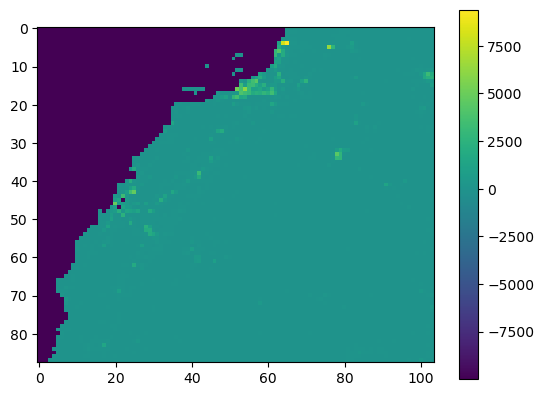

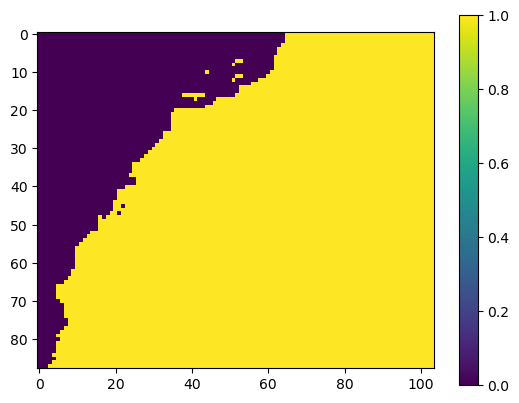

/Users/Guille/Desktop/caiso_power/output/auxiliary/USland_0.125_(-125,-112)_(32,43).pkl


In [4]:
plt.figure()
plt.imshow(z_ref_.reshape(M, N))
plt.colorbar()
plt.show()

z_p_ = np.ones(z_ref_.shape)
z_p_[z_ref_ == z_ref_.min()] = 0

plt.figure()
plt.imshow(z_p_.reshape(M, N))
plt.colorbar()
plt.show()

# Compose saving name
file_name = path_to_oax + 'USland_{}_({},{})_({},{}).pkl'.format(delta, lon_min, lon_max, lat_min, lat_max)
with open(file_name, 'wb') as _f:
    pickle.dump(z_p_, _f, protocol = pickle.HIGHEST_PROTOCOL)
print(file_name)

               NAME  Id                                           geometry
0              BANC   0  MULTIPOLYGON (((-137060.977 -20577.830, -13688...
1            CALISO   0  MULTIPOLYGON (((462257.252 -497407.760, 463725...
2               IID   0  POLYGON ((462362.442 -497410.335, 460826.878 -...
3             LADWP   0  MULTIPOLYGON (((155513.796 -60191.108, 156290....
4         NV Energy   0  POLYGON ((-107.678 179976.721, -109.123 179188...
5               TID   0  MULTIPOLYGON (((-49324.923 -90615.523, -48079....
6              WALC   0  MULTIPOLYGON (((498596.693 -497179.374, 495449...
7            CALISO   0  POLYGON ((-254205.250 270945.288, -254395.333 ...
8  PacificCorp West   0  POLYGON ((-193220.045 445064.081, -192189.846 ...


<AxesSubplot:>

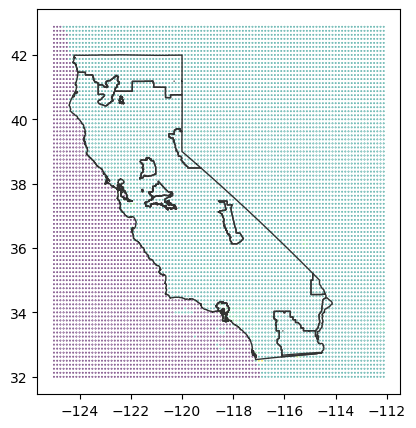

In [5]:
_CAISO = gpd.read_file(path_to_data + r"maps/CAISO/Balancing_Authority_Areas_in_CA.shp")
print(_CAISO)

fig, ax = plt.subplots(1, figsize = (5, 5))

ax.scatter(W_ref_[:, 0], W_ref_[:, 1], c     = z_ref_, 
                                       s     = .1,
                                       alpha = 1.)

_CAISO.to_crs("EPSG:4326").plot(ax        = ax, 
                                linewidth = 1., 
                                edgecolor = '0.2', 
                                color     = 'None', 
                                facecolor = 'none')

# Processing World Altitude Atlas

In [6]:
#30,-150,50,-120
Z_1_ = rasterio.open(path_to_data + r"30N150W_20101117_gmted_mea300.tiff").read()[0, ...]

#30,-120,50,-90
Z_2_ = rasterio.open(path_to_data + r"30N120W_20101117_gmted_mea300.tiff").read()[0, ...]
print(Z_1_.shape, Z_2_.shape)

# Combine both patches into one
Z_ = np.concatenate((Z_1_, Z_2_), axis = 1)
z_prime_ = Z_.flatten()
print(Z_.shape, z_prime_.shape)

# Define grid Coordiantes
x_ = np.linspace(-150., -90., Z_.shape[1])
y_ = np.linspace(30., 50., Z_.shape[0])[::-1]
print(x_.shape, y_.shape)

# Define the desired grid coordinates
X_, Y_   = np.meshgrid(x_, y_)
W_prime_ = np.concatenate((X_.flatten()[:, np.newaxis], 
                           Y_.flatten()[:, np.newaxis]), axis = 1)
print(W_prime_.shape)

# Find coodiantes withint California region
idx_x_ = (W_prime_[:, 0] > lon_min) & (W_prime_[:, 0] < lon_max)
idx_y_ = (W_prime_[:, 1] > lat_min) & (W_prime_[:, 1] < lat_max)
index_ = idx_x_ & idx_y_

# Select California Region
W_prime_prime_ = W_prime_[index_, :]
z_prime_prime_ = z_prime_[index_]
print(W_prime_prime_.shape, z_prime_prime_.shape)

# Perfom Interpolation
h_ref_ = griddata(W_prime_prime_, z_prime_prime_, (W_ref_[:, 0], W_ref_[:, 1]), method = 'nearest')
print(h_ref_.shape)

# Compose saving name
file_name = path_to_oax + 'altitude_grid_{}_({},{})_({},{}).pkl'.format(delta, lon_min, lon_max, lat_min, lat_max)
with open(file_name, 'wb') as _f:
    pickle.dump(h_ref_, _f, protocol = pickle.HIGHEST_PROTOCOL)
print(file_name)

(2400, 3600) (2400, 3600)
(2400, 7200) (17280000,)
(7200,) (2400,)
(17280000, 2)
(2059200, 2) (2059200,)
(9152,)
/Users/Guille/Desktop/caiso_power/output/auxiliary/altitude_grid_0.125_(-125,-112)_(32,43).pkl


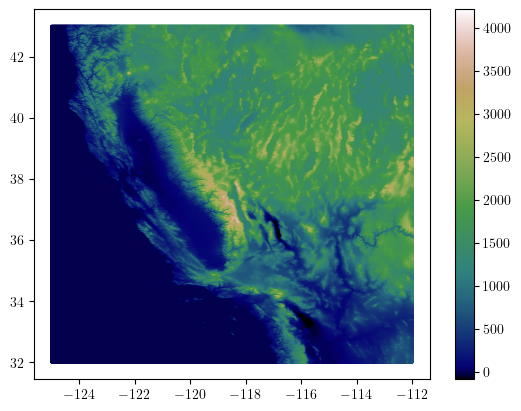

In [18]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import AxesGrid


plt.figure()
plt.scatter(W_prime_prime_[:, 0], W_prime_prime_[:, 1], 1, z_prime_prime_, cmap = "gist_earth")
plt.colorbar()
plt.show()

               NAME  Id                                           geometry
0              BANC   0  MULTIPOLYGON (((-137060.977 -20577.830, -13688...
1            CALISO   0  MULTIPOLYGON (((462257.252 -497407.760, 463725...
2               IID   0  POLYGON ((462362.442 -497410.335, 460826.878 -...
3             LADWP   0  MULTIPOLYGON (((155513.796 -60191.108, 156290....
4         NV Energy   0  POLYGON ((-107.678 179976.721, -109.123 179188...
5               TID   0  MULTIPOLYGON (((-49324.923 -90615.523, -48079....
6              WALC   0  MULTIPOLYGON (((498596.693 -497179.374, 495449...
7            CALISO   0  POLYGON ((-254205.250 270945.288, -254395.333 ...
8  PacificCorp West   0  POLYGON ((-193220.045 445064.081, -192189.846 ...


<AxesSubplot:>

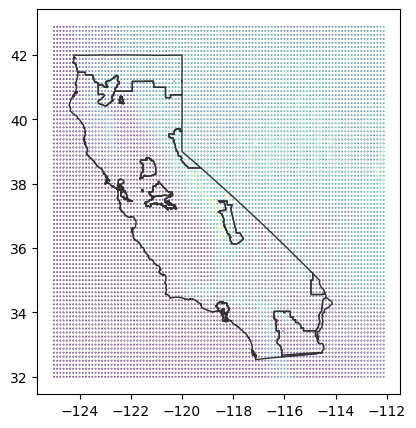

In [8]:
_CAISO = gpd.read_file(path_to_data + r"maps/CAISO/Balancing_Authority_Areas_in_CA.shp")
print(_CAISO)

fig, ax = plt.subplots(1, figsize = (5, 5))

ax.scatter(W_ref_[:, 0], W_ref_[:, 1], c     = h_ref_, 
                                       s     = .1,
                                       alpha = 1.)

_CAISO.to_crs("EPSG:4326").plot(ax        = ax, 
                                linewidth = 1., 
                                edgecolor = '0.2', 
                                color     = 'None', 
                                facecolor = 'none')

# Wind and Solar Generation Density Atlas

In [9]:
def _prob_generation(X_, X_grid_, l = 1.):
    
    i_ = np.zeros((X_grid_.shape[0],))
    z_ = np.zeros((X_grid_.shape[0],))
    
    for i in range(X_.shape[0]):
        X_prime_ = np.ones((X_grid_.shape[0], 1)) @ X_[i, :2][:, np.newaxis].T
        
        d_ = np.sqrt(np.mean((X_grid_ - X_prime_)**2, axis = 1))

        i_ += np.exp(-d_/l)
        z_ += X_[i, -1]*np.exp(-d_/l)
        
    i_ /= i_.sum()
    z_ /= z_.sum()
    return i_, z_


csv_file_name = r'California_Power_Plants.csv'

data_ = pd.read_csv(path_to_data + csv_file_name).to_numpy()
print(data_.shape)

data_prime_ = data_[data_[:, 18] == 0, :]
print(data_prime_.shape)

data_prime_prime_ = data_prime_[:, [0, 1, 18, 29, 31]]
W_, S_ = [], []
for i in range(data_prime_prime_.shape[0]):
    resource = data_prime_prime_[i, -1]
    if resource == 'SUN':
        S_.append(data_prime_prime_[i, [0, 1, 3]][np.newaxis, :])
    if resource == 'WND':
        W_.append(data_prime_prime_[i, [0, 1, 3]][np.newaxis, :])
        
S_ = np.concatenate(S_, axis = 0).astype(float)
W_ = np.concatenate(W_, axis = 0).astype(float)
print(S_.shape, W_.shape)

R_ = np.concatenate((S_, W_), axis = 0)

z_s_ = _prob_generation(S_, W_ref_, l = .1)[1]
z_w_ = _prob_generation(W_, W_ref_, l = .1)[1]

# Compose saving name
file_name = path_to_oax + 'solar_density_grid_{}_({},{})_({},{}).pkl'.format(delta, lon_min, lon_max, lat_min, lat_max)
with open(file_name, 'wb') as _f:
    pickle.dump(z_s_, _f, protocol = pickle.HIGHEST_PROTOCOL)
print(file_name)

# Compose saving name
file_name = path_to_oax + 'wind_density_grid_{}_({},{})_({},{}).pkl'.format(delta, lon_min, lon_max, lat_min, lat_max)
with open(file_name, 'wb') as _f:
    pickle.dump(z_w_, _f, protocol = pickle.HIGHEST_PROTOCOL)
print(file_name)

(1859, 39)
(1632, 39)
(777, 3) (118, 3)
/Users/Guille/Desktop/caiso_power/output/auxiliary/solar_density_grid_0.125_(-125,-112)_(32,43).pkl
/Users/Guille/Desktop/caiso_power/output/auxiliary/wind_density_grid_0.125_(-125,-112)_(32,43).pkl


               NAME  Id                                           geometry
0              BANC   0  MULTIPOLYGON (((-137060.977 -20577.830, -13688...
1            CALISO   0  MULTIPOLYGON (((462257.252 -497407.760, 463725...
2               IID   0  POLYGON ((462362.442 -497410.335, 460826.878 -...
3             LADWP   0  MULTIPOLYGON (((155513.796 -60191.108, 156290....
4         NV Energy   0  POLYGON ((-107.678 179976.721, -109.123 179188...
5               TID   0  MULTIPOLYGON (((-49324.923 -90615.523, -48079....
6              WALC   0  MULTIPOLYGON (((498596.693 -497179.374, 495449...
7            CALISO   0  POLYGON ((-254205.250 270945.288, -254395.333 ...
8  PacificCorp West   0  POLYGON ((-193220.045 445064.081, -192189.846 ...


<AxesSubplot:>

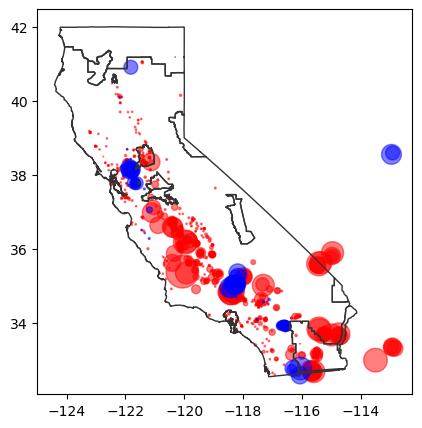

In [10]:
_CAISO = gpd.read_file(path_to_data + r"maps/CAISO/Balancing_Authority_Areas_in_CA.shp")
print(_CAISO)

fig, ax = plt.subplots(1, figsize = (5., 5.))

ax.scatter(S_[:, 0], S_[:, 1], c = 'r', 
                               s = S_[:, 2], alpha = 0.5)
ax.scatter(W_[:, 0], W_[:, 1], c     = 'b', 
                               s     = W_[:, 2], 
                               alpha = 0.5)
_CAISO.to_crs("EPSG:4326").plot(ax        = ax, 
                                linewidth = 1., 
                                edgecolor = '0.2', 
                                color     = 'None', 
                                facecolor = 'none')

# Visualize Spatial Data

               NAME  Id                                           geometry
0              BANC   0  MULTIPOLYGON (((-137060.977 -20577.830, -13688...
1            CALISO   0  MULTIPOLYGON (((462257.252 -497407.760, 463725...
2               IID   0  POLYGON ((462362.442 -497410.335, 460826.878 -...
3             LADWP   0  MULTIPOLYGON (((155513.796 -60191.108, 156290....
4         NV Energy   0  POLYGON ((-107.678 179976.721, -109.123 179188...
5               TID   0  MULTIPOLYGON (((-49324.923 -90615.523, -48079....
6              WALC   0  MULTIPOLYGON (((498596.693 -497179.374, 495449...
7            CALISO   0  POLYGON ((-254205.250 270945.288, -254395.333 ...
8  PacificCorp West   0  POLYGON ((-193220.045 445064.081, -192189.846 ...


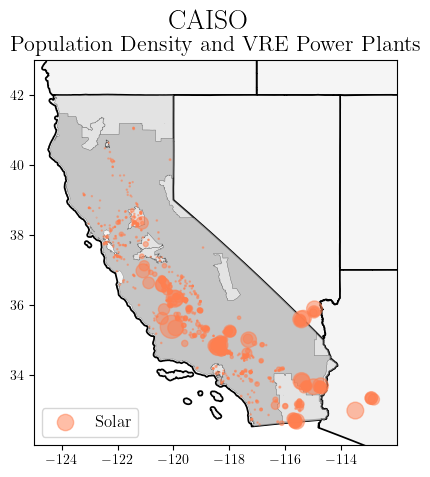

-124.9965272954577 -112.00305597999721
32.00083368070029 42.99708211754898


In [11]:
from matplotlib import rc

rc('font', **{'family': 'serif', 'serif': ['Computer Modern']})
rc('text', usetex = True)

path_to_map = r"/Users/Guille/Desktop/extreme_scenarios/data/"

_CAISO = gpd.read_file(path_to_data + r"maps/CAISO/Balancing_Authority_Areas_in_CA.shp")
_US    = gpd.read_file(path_to_map + r"tl_2022_us_state/tl_2022_us_state.shp")
print(_CAISO)


fig, ax = plt.subplots(1, figsize = (5, 5))

plt.suptitle('CAISO', fontsize = 20)
plt.title('Population Density and VRE Power Plants', fontsize = 16)

_CAISO.to_crs("EPSG:4326").plot(ax        = ax, 
                                linewidth = .25, 
                                edgecolor = 'k', 
                                facecolor = 'k', 
                                color     = 'lightgray', 
                                alpha = 0.5, zorder = 1)

_US.to_crs("EPSG:4326").plot(ax        = ax, 
                                linewidth = 1.25, 
                                edgecolor = 'k', 
                                facecolor = 'k',
                                color     = 'whitesmoke', zorder = 0)

_CAISO_prime_ = _CAISO.iloc[[1, 7]].to_crs("EPSG:4326")
_CAISO_prime_.plot(ax        = ax, 
                                linewidth = 0., 
                                edgecolor = 'None', 
                                facecolor = 'None', 
                                color     = 'darkgray', 
                                alpha = 0.5, zorder = 2)

ax.scatter(S_[:, 0], S_[:, 1], c = 'coral', 
                               s = S_[:, 2]/2., alpha = 0.5, zorder = 3, label = 'Solar')

# ax.scatter(W_[:, 0], W_[:, 1], c = 'skyblue', 
#                                s = W_[:, 2]/2., alpha = 0.5, zorder = 3, label = 'Wind')
idx_p_ = z_ref_ > 100.

# idx_ = []
# print()
# # Loop over Grid coordinates
# for i in range(W_ref_[idx_p_, :].shape[0]):
#     if _CAISO_prime_.contains(Point([W_ref_[idx_p_, 0][i], W_ref_[idx_p_, 1][i]])).any():
#         idx_.append(i)
# ax.scatter(W_ref_[idx_p_, 0][idx_], W_ref_[idx_p_, 1][idx_], c     = 'teal', 
#                                              s     = z_ref_[idx_p_][idx_]/100.,
#                                              alpha = .5, zorder = 3, label = 'Population')

plt.legend(loc = 'lower left', fontsize = 12)

#ax.set_axis_off()
ax.set_xlim(W_prime_prime_[:, 0].min(), W_prime_prime_[:, 0].max())
ax.set_ylim(W_prime_prime_[:, 1].min(), W_prime_prime_[:, 1].max())
plt.savefig(path_to_images + "CAISO-map.pdf", dpi = 100)
plt.show()

print(W_prime_prime_[:, 0].min(), W_prime_prime_[:, 0].max())
print(W_prime_prime_[:, 1].min(), W_prime_prime_[:, 1].max())
    
# fig, ax = plt.subplots(1, figsize = (5, 5))

# ax.scatter(W_ref_[:, 0], W_ref_[:, 1], c = z_s_, alpha = 0.25)

# _CAISO.to_crs("EPSG:4326").plot(ax        = ax, 
#                                 linewidth = 1., 
#                                 edgecolor = '0.2', 
#                                 color     = 'None', 
#                                 facecolor = 'none')

# fig, ax = plt.subplots(1, figsize = (5, 5))

# ax.scatter(W_ref_[:, 0], W_ref_[:, 1], c = z_w_, alpha = 0.25)

# _CAISO.to_crs("EPSG:4326").plot(ax        = ax, 
#                                 linewidth = 1., 
#                                 edgecolor = '0.2', 
#                                 color     = 'None', 
#                                 facecolor = 'none')

# Heuristic for Dimensionality Reduction

In [54]:
# Compose saving name
file_name = path_to_oax + 'population_density_grid_{}_({},{})_({},{}).pkl'.format(delta, lon_min, lon_max, lat_min, lat_max)
with open(file_name, 'rb') as _f:
    Z_ = pickle.load(_f)
print(file_name)

idx_ = Z_ > 100.
P_   = np.concatenate([W_ref_[idx_, 0][:, np.newaxis], W_ref_[idx_, 1][:, np.newaxis], Z_[idx_][:, np.newaxis]], axis = 1)
print(P_.shape, Z_.shape, W_ref_.shape)

_CAISO = gpd.read_file(path_to_data + r"maps/CAISO/Balancing_Authority_Areas_in_CA.shp")
_CAISO = _CAISO.iloc[[1, 7]].to_crs("EPSG:4326")

# Loop over Grid coordinates
idx_ = []
for i in range(P_.shape[0]):
    if _CAISO.contains(Point([P_[:, 0][i], P_[:, 1][i]])).any():
        idx_.append(i)
P_ = P_[idx_, :]
print(P_.shape, S_.shape, W_.shape)

/Users/Guille/Desktop/caiso_power/output/auxiliary/population_density_grid_0.125_(-125,-112)_(32,43).pkl
(291, 3) (9152,) (9152, 2)
(179, 3) (777, 3) (118, 3)


2327.0


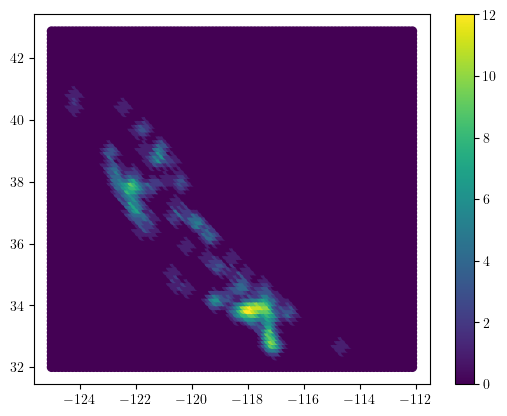

9802.0


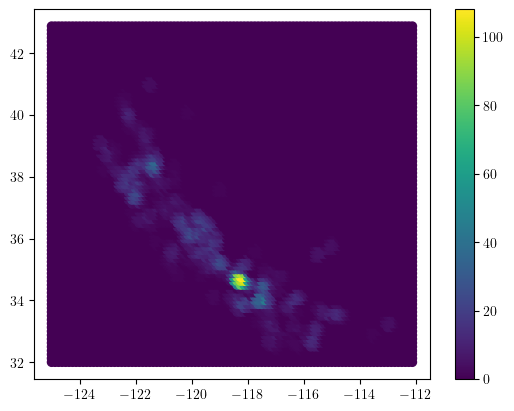

1511.0


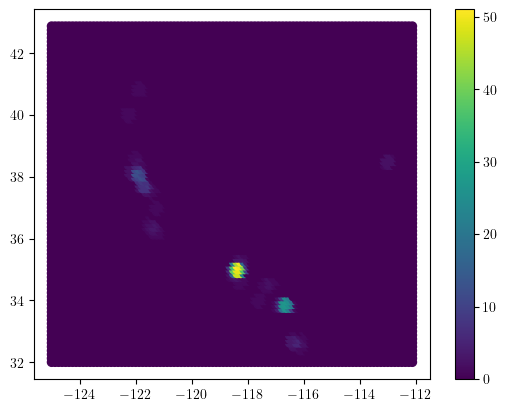

13640.0


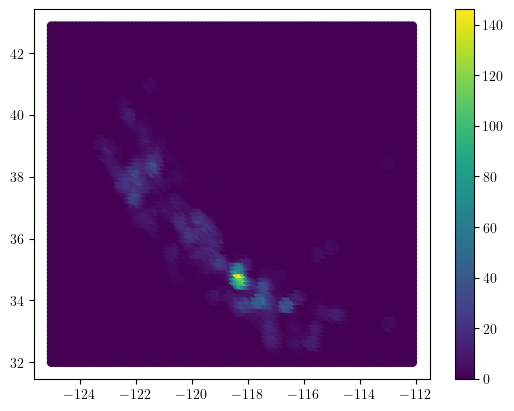

/Users/Guille/Desktop/caiso_power/output/auxiliary/density_grid_0.125_(-125,-112)_(32,43).pkl


In [56]:
def _find_radius(X_, X_ref_, r):
    
    X_map_ = np.zeros((X_ref_.shape[0],))
    for i in range(X_.shape[0]):
        d_ = np.sqrt(np.sum((X_ref_ - X_[i, :])**2, axis = 1))    
        X_map_[d_ <= r] += 1.
    
    return X_map_

P_map_ = _find_radius(P_[:, :2], W_ref_, r = .25)
print(P_map_.sum())

plt.figure()
plt.scatter(W_ref_[:, 0], W_ref_[:, 1], c = P_map_)
plt.colorbar()
plt.show()

S_map_ = _find_radius(S_[:, :2], W_ref_, r = .25)
print(S_map_.sum())

plt.figure()
plt.scatter(W_ref_[:, 0], W_ref_[:, 1], c = S_map_)
plt.colorbar()
plt.show()

W_map_ = _find_radius(W_[:, :2], W_ref_, r = .25)
print(W_map_.sum())
   
plt.figure()
plt.scatter(W_ref_[:, 0], W_ref_[:, 1], c = W_map_)
plt.colorbar()
plt.show()

X_map_ = P_map_ + S_map_ + W_map_
print(X_map_.sum())

plt.figure()
plt.scatter(W_ref_[:, 0], W_ref_[:, 1], c = X_map_)
plt.colorbar()
plt.show()

# Compose saving name
file_name = path_to_oax + 'density_grid_{}_({},{})_({},{}).pkl'.format(delta, lon_min, lon_max, lat_min, lat_max)
with open(file_name, 'wb') as _f:
    pickle.dump([P_map_, S_map_, W_map_], _f, protocol = pickle.HIGHEST_PROTOCOL)
print(file_name)

# Reference Grid with Zone Labels

In [85]:
_CAISO = gpd.read_file(path_to_data + r"maps/CAISO/Balancing_Authority_Areas_in_CA.shp")
print(_CAISO)

N, D = W_ref_.shape
print(N, D)
# Meters to Longitude and latiture
_map = _CAISO['geometry'].to_crs("EPSG:4326")

L_ = np.zeros((N,))

# Loop over Grid coordinates
for i in range(N):
    # Check coordinate point region
    for j in range(8):
        if _map[j].contains(Point([W_ref_[i, 0], W_ref_[i, 1]])):
            L_[i] = j + 1
            
# Compose saving name
file_name = path_to_oax + 'CAISO_utilities_{}_({},{})_({},{}).pkl'.format(delta, lon_min, lon_max, lat_min, lat_max)
with open(file_name, 'wb') as _f:
    pickle.dump(z_w_, _f, protocol = pickle.HIGHEST_PROTOCOL)
print(file_name)

L_prime_ = L_.reshape(88, 104)
print(L_prime_.shape)

plt.figure()
plt.imshow(L_prime_[::-1])
plt.show()

idx_ = L_prime_ > 0.
print(idx_.sum(), L_.shape)

CRSError: Invalid projection: PROJCS["NAD83 / California Albers",GEOGCS["NAD83",DATUM["North_American_Datum_1983",SPHEROID["GRS 1980",6378137,298.257222101,AUTHORITY["EPSG","7019"]],AUTHORITY["EPSG","6269"]],PRIMEM["Greenwich",0],UNIT["Degree",0.0174532925199433],AUTHORITY["EPSG","4269"]],PROJECTION["Albers_Conic_Equal_Area"],PARAMETER["latitude_of_center",0],PARAMETER["longitude_of_center",-120],PARAMETER["standard_parallel_1",34],PARAMETER["standard_parallel_2",40.5],PARAMETER["false_easting",0],PARAMETER["false_northing",-4000000],UNIT["metre",1,AUTHORITY["EPSG","9001"]],AXIS["Easting",EAST],AXIS["Northing",NORTH]]: (Internal Proj Error: proj_create: SQLite error on SELECT name, ellipsoid_auth_name, ellipsoid_code, prime_meridian_auth_name, prime_meridian_code, area_of_use_auth_name, area_of_use_code, publication_date, deprecated FROM geodetic_datum WHERE auth_name = ? AND code = ?: no such column: area_of_use_auth_name)

# OASIS CAISO API - Energy Demand and Wind and Solar Generation 

In [188]:
year = 2020

# Retrive a year long data
_start_date = date(year, 1, 1)
_end_date   = date(year + 1, 1, 1)
N_days      = (_end_date - _start_date).days
print(N_days)

# Loop over number of days
for i in range(N_days):
    
    # Get daylong data request
    _delta    = timedelta(days = 1)
    _end_date = _start_date + _delta

    # Get date in API request format
    start_date = f"{_start_date.year:02}{_start_date.month:02}{_start_date.day:02}"
    end_date   = f"{_end_date.year:02}{_end_date.month:02}{_end_date.day:02}"
    
    # Got to next day
    _start_date += _delta
    
year  = 2020
month = 8
day   = 10

# Define initial date in datetime format
_start_date = date(year, month, day)

# Get daylong data request
_delta    = timedelta(days = 1)
_end_date = _start_date + _delta

# Get date in API request format
start_date = f"{_start_date.year:02}{_start_date.month:02}{_start_date.day:02}"
end_date   = f"{_end_date.year:02}{_end_date.month:02}{_end_date.day:02}"

# Got to next day
_start_date += _delta

366


In [5]:
# GMT: Greenwich Mean Time
def _download_csv(url, zip_file_name = 'temp.zip'):
    print(url)
    # Request file on the url
    response = requests.get(url, stream = True)
    # Downalaod zip file from url
    with open(zip_file_name, "wb") as f:
        for chunk in response.iter_content(chunk_size=512):
            if chunk:  # filter out keep-alive new chunks
                f.write(chunk)
    # unzip file      
    with zipfile.ZipFile(zip_file_name, 'r') as zip_ref:
        zip_ref.extractall('')
    # Find unzip .csv in temp folder
    csv_file_name = glob.glob('*.csv')[0]
    # Open /csv file
    df_ = pd.read_csv(csv_file_name)
    # Remove temp files
    os.remove(csv_file_name)
    os.remove(zip_file_name)
    return df_

# Process OASIS CAISO renewable energy generation data and save it in pickle files
def _process_renewable_energy_generation(i_data_, path, date):
    
    # Loop over available renewable resource
    for i in range(len(i_data_['RENEWABLE_TYPE'].unique())):
        
        # Initialize storage dataframe
        o_data_ = pd.DataFrame()
        # Loop over traiding hub
        for j in range(len(i_data_['TRADING_HUB'].unique())):
            # Get Data from Trading hub
            idx_ = (i_data_['RENEWABLE_TYPE'] == i_data_['RENEWABLE_TYPE'].unique()[i]) & (i_data_['TRADING_HUB'] == i_data_['TRADING_HUB'].unique()[j])
            # Sort data from hourly sequence
            idx_prime_       = i_data_['OPR_HR'][idx_].to_numpy()
            idx_prime_prime_ = np.argsort(idx_prime_)
            time_            = idx_prime_[idx_prime_prime_]
            energy_          = i_data_['MW'][idx_].to_numpy()[idx_prime_prime_]

            # Dont save data when a trading hub does not have a resource
            if len(energy_) == 0: 
                print(i_data_['RENEWABLE_TYPE'].unique()[i], i_data_['TRADING_HUB'].unique()[j])
                break

            # Storage Data in dataframe
            o_data_[i_data_['TRADING_HUB'].unique()[j]] = energy_
            
        # Get renewalbe generation resource
        resource = i_data_['RENEWABLE_TYPE'].unique()[i]
        print(o_data_.shape)
        # Save renewable resource energy generation data in pickle file
        _save_CAISO_data_in_pickle_file(o_data_, path, resource, date)


# Process OASIS CAISO energy demand data and save it in pickle files
def _process_energy_demand(i_data_, path, date):
    resource = r'Demand'
    # Initialize storage dataframe
    o_data_ = pd.DataFrame()

    # Loop over TAC areas
    for i in range(len(i_data_['TAC_AREA_NAME'].unique())):
        print(i_data_['TAC_AREA_NAME'].unique()[i])
        # Get Data from TAC area
        idx_ = i_data_['TAC_AREA_NAME'] == i_data_['TAC_AREA_NAME'].unique()[i]
        # Sort data from hourly sequence
        idx_prime_       = i_data_['OPR_HR'][idx_].to_numpy()
        idx_prime_prime_ = np.argsort(idx_prime_)
        time_            = idx_prime_[idx_prime_prime_]
        energy_          = i_data_['MW'][idx_].to_numpy()[idx_prime_prime_]
        # Storage Data in dataframe
        o_data_[i_data_['TAC_AREA_NAME'].unique()[i]] = energy_

    print(o_data_.shape)
    # Save energy demand in pickle file
    _save_CAISO_data_in_pickle_file(o_data_, path, resource, date)

# Save CAISO data in a pickle file
def _save_CAISO_data_in_pickle_file(data_, path, resource, date):
    # Compose saving name
    file_name = path + resource + r'_' + date + r'.pkl'
    with open(file_name, 'wb') as _f:
        pickle.dump(data_, _f, protocol = pickle.HIGHEST_PROTOCOL)

In [4]:
forecasts = 0

year  = 2020
month = 8
day   = 10
    
market = ["ACTUAL", "DAM"][forecasts]
path   = [path_to_oac, path_to_ofc][forecasts]

# Define initial date in datetime format
_start_date = date(year, month, day)

# Get daylong data request
_delta    = timedelta(days = 1)
_end_date = _start_date + _delta

# Get date in API request format
start_date = f"{_start_date.year:02}{_start_date.month:02}{_start_date.day:02}"
end_date   = f"{_end_date.year:02}{_end_date.month:02}{_end_date.day:02}"
print(market, start_date, end_date, path)

# Define renewable energy generation CAISO url API request
renewable_url = r"http://oasis.caiso.com/oasisapi/SingleZip?queryname=SLD_REN_FCST&market_run_id={}&resultformat=6&startdatetime={}T07:00-0000&enddatetime={}T07:00-0000&version=1".format(market, start_date, end_date)
print(renewable_url)

# Define energy demand CAISO url API request
demand_url = r"http://oasis.caiso.com/oasisapi/SingleZip?resultformat=6&queryname=SLD_FCST&version=1&market_run_id={}&startdatetime={}T07:00-0000&enddatetime={}T07:00-0000".format(market, start_date, end_date)
print(demand_url)

# Download renewable generation data
i_renewable_ = _download_csv(renewable_url, zip_file_name = 'temp.zip')

# Download energy demand data
i_demand_ = _download_csv(demand_url, zip_file_name = 'temp.zip')

_process_renewable_energy_generation(i_renewable_, path, start_date)

_process_energy_demand(i_demand_, path, start_date)

ACTUAL 20200810 20200811 /Users/Guille/Desktop/caiso_power/output/actuals/
http://oasis.caiso.com/oasisapi/SingleZip?queryname=SLD_REN_FCST&market_run_id=ACTUAL&resultformat=6&startdatetime=20200810T07:00-0000&enddatetime=20200811T07:00-0000&version=1
http://oasis.caiso.com/oasisapi/SingleZip?resultformat=6&queryname=SLD_FCST&version=1&market_run_id=ACTUAL&startdatetime=20200810T07:00-0000&enddatetime=20200811T07:00-0000
http://oasis.caiso.com/oasisapi/SingleZip?queryname=SLD_REN_FCST&market_run_id=ACTUAL&resultformat=6&startdatetime=20200810T07:00-0000&enddatetime=20200811T07:00-0000&version=1
http://oasis.caiso.com/oasisapi/SingleZip?resultformat=6&queryname=SLD_FCST&version=1&market_run_id=ACTUAL&startdatetime=20200810T07:00-0000&enddatetime=20200811T07:00-0000
120
120
120
(24, 3)
120
120
120
Wind ZP26
(24, 2)
AZPS
BANCSMUD
BCHA
CA ISO-TAC
IPCO
MWD-TAC
NEVP
PACE
PACW
PGE
PGE-TAC
PSEI
SCE-TAC
SCL
SDGE-TAC
SRP
VEA-TAC
(24, 17)


In [35]:
forecasts = 0
year      = 2020

market = ["ACTUAL", "DAM"][forecasts]
path   = [path_to_oac, path_to_ofc][forecasts]

# Retrive a year long data
_start_date = date(year, 1, 1)
_end_date   = date(year + 1, 1, 1)
N_days      = (_end_date - _start_date).days

# Timestamp
_delta = timedelta(days = 1)
    
bucket = r'http://oasis.caiso.com/oasisapi/SingleZip?queryname='
# Loop over number of days
for i in range(N_days):

    # Get daylong data request
    _end_date = _start_date + _delta

    # Get date in API request format
    start_date = f"{_start_date.year:02}{_start_date.month:02}{_start_date.day:02}"
    end_date   = f"{_end_date.year:02}{_end_date.month:02}{_end_date.day:02}"
    
    # Define renewable energy generation CAISO url API request
    renewable_url = r"SLD_REN_FCST&market_run_id={}&resultformat=6&startdatetime={}T07:00-0000&enddatetime={}T07:00-0000&version=1".format(market, start_date, end_date)
    # Define energy demand CAISO url API request
    demand_url = r"SLD_FCST&version=1&market_run_id={}&startdatetime={}T07:00-0000&enddatetime={}T07:00-0000".format(market, start_date, end_date)
    # Download renewable generation data
    i_renewable_ = _download_csv(bucket + renewable_url, zip_file_name = 'temp.zip')
    # Download energy demand data
    i_demand_ = _download_csv(bucket + demand_url, zip_file_name = 'temp.zip')

    _process_renewable_energy_generation(i_renewable_, path, start_date)
    _process_energy_demand(i_demand_, path, start_date)

    # Got to next day
    _start_date += _delta 

    sleep(5.)

SyntaxError: expression cannot contain assignment, perhaps you meant "=="? (4084810924.py, line 31)

# OASIS CAISO API - Local Marginal Prices

In [126]:
# Processing LMP data
def _process(data_, key):
    # Find node names in the csv
    nodes_ = np.unique(data_['NODE'])
    # Find intervals in between prices in the csv
    interval_ = np.unique(data_['OPR_INTERVAL'])
    # Initialize storage variable
    data_prime_ = np.zeros((len(nodes_), len(interval_) + 1), dtype = object)
    data_prime_[:, 0] = nodes_
    # Loop over nodes in the csv
    for i in range(len(nodes_)):
        # Find data from a given node and the desired type LMP
        index_ = (data_['NODE'] == nodes_[i]) & (data_['LMP_TYPE'] == 'LMP')
        # Make sure the data is organized sequencially by operational interval get values on the key
        data_prime_[i, data_['OPR_INTERVAL'][index_].to_numpy()] = data_[key][index_].to_numpy()
    return data_prime_

year = 2020

forecasts = 1

market = ["RTPD", "INTVL", "HASP"][forecasts]
path   = [path_to_oac, path_to_oac, path_to_ofc][forecasts]

# Retrive a year long data
_start_date = date(year, 1, 1)
_end_date   = date(year + 1, 1, 1)
N_days      = (_end_date - _start_date).days
print(_start_date)

# Timestamp
_delta = timedelta(days = 1/24)

# Define url to the bucket
bucket = r'http://oasis.caiso.com/oasisapi/SingleZip?resultformat=6&queryname='

# Get date in API request format
start_date  = f"{_start_date.year:02}{_start_date.month:02}{_start_date.day:02}"
_start_date = datetime.strptime(start_date,"%Y%m%d").replace(hour = 0)

# Initilize storage variable
data_prime_ = []
for i in range(24):
    
    # Get hourlong data request
    _end_date = _start_date + _delta

    # Define date interval for url requester
    start_date = f"{_start_date.year:02}{_start_date.month:02}{_start_date.day:02}T{_start_date.hour:02}"
    end_date   = f"{_end_date.year:02}{_end_date.month:02}{_end_date.day:02}T{_end_date.hour:02}"
    #print(start_date, end_date)
    
    if forecasts == 0:
        # Define url request for real-time 15-minutes LMP 
        url   = 'PRC_RTPD_LMP&version=3&startdatetime={}:00-0000&enddatetime={}:00-0000&market_run_id=RTPD&grp_type=ALL_APNODES'.format(start_date, end_date)
        # Download real-time 15-minutes LMPs 
        RTPD_ = _download_csv(bucket + url, zip_file_name = 'temp.zip')
        data_ = _process(RTPD_, key = 'PRC')

    if forecasts == 1:
        # Define url request for real-time 5-minutes LMPs
        url    = 'PRC_INTVL_LMP&version=3&startdatetime={}:00-0000&enddatetime={}:00-0000&market_run_id=RTM&grp_type=ALL_APNODES'.format(start_date, end_date)
        # Download real-time 5-minutes LMPs 
        INTVL_ = _download_csv(bucket + url, zip_file_name = 'temp.zip')
        data_  = _process(INTVL_, key = 'VALUE')

    if forecasts == 2:
        # Define url request for day ahead forecast 15-minutes LMPs
        url   = 'PRC_HASP_LMP&version=3&startdatetime={}:00-0000&enddatetime={}:00-0000&market_run_id=HASP&grp_type=ALL_APNODES'.format(start_date, end_date)
        # Download day ahead forecast 15-minutes LMPs
        HASP_ = _download_csv(bucket + url, zip_file_name = 'temp.zip')
        data_ = _process(HASP_, key = 'MW')

    data_prime_.append(data_)
    
    # Got to next day
    _start_date += _delta 

_save_CAISO_data_in_pickle_file(data_prime_, path, market, start_date)

    

2020-01-01
http://oasis.caiso.com/oasisapi/SingleZip?resultformat=6&queryname=PRC_INTVL_LMP&version=3&startdatetime=20200101T00:00-0000&enddatetime=20200101T01:00-0000&market_run_id=RTM&grp_type=ALL_APNODES
http://oasis.caiso.com/oasisapi/SingleZip?resultformat=6&queryname=PRC_INTVL_LMP&version=3&startdatetime=20200101T01:00-0000&enddatetime=20200101T02:00-0000&market_run_id=RTM&grp_type=ALL_APNODES
http://oasis.caiso.com/oasisapi/SingleZip?resultformat=6&queryname=PRC_INTVL_LMP&version=3&startdatetime=20200101T02:00-0000&enddatetime=20200101T03:00-0000&market_run_id=RTM&grp_type=ALL_APNODES
http://oasis.caiso.com/oasisapi/SingleZip?resultformat=6&queryname=PRC_INTVL_LMP&version=3&startdatetime=20200101T03:00-0000&enddatetime=20200101T04:00-0000&market_run_id=RTM&grp_type=ALL_APNODES
http://oasis.caiso.com/oasisapi/SingleZip?resultformat=6&queryname=PRC_INTVL_LMP&version=3&startdatetime=20200101T04:00-0000&enddatetime=20200101T05:00-0000&market_run_id=RTM&grp_type=ALL_APNODES
http://oa

KeyboardInterrupt: 

In [5]:
# GMT: Greenwich Mean Time
def _download_csv(url, zip_file_name = 'temp.zip'):
    print(url)
    # Request file on the url
    response = requests.get(url, stream = True)
    # Downalaod zip file from url
    with open(zip_file_name, "wb") as f:
        for chunk in response.iter_content(chunk_size=512):
            if chunk:  # filter out keep-alive new chunks
                f.write(chunk)
    # unzip file      
    with zipfile.ZipFile(zip_file_name, 'r') as zip_ref:
        zip_ref.extractall('')
    # Find unzip .csv in temp folder
    csv_file_name = glob.glob('*.csv')[0]
    # Open /csv file
    df_ = pd.read_csv(csv_file_name)
    # Remove temp files
    os.remove(csv_file_name)
    os.remove(zip_file_name)
    return df_

# Processing LMP data
def _processing_LMPs(data_):
    # Find node names in the csv
    index_     = data_['LMP_TYPE'] == 'LMP'
    intervals_ = data_['OPR_INTERVAL'][index_].to_numpy()
    values_    = data_['VALUE'][index_].to_numpy()
    return np.array([values_[i] for i in np.argsort(intervals_)])

bucket = r'http://oasis.caiso.com/oasisapi/SingleZip?'

year   = 2020
market = ['RTM'][0]

# Retrive a year long data
_start_date = date(year, 1, 1)
_end_date   = date(year + 1, 1, 1)
N_days      = (_end_date - _start_date).days
print(_start_date)

# Timestamp
_dt = timedelta(days = 1/24)

# Get date in API request format
start_date  = f"{_start_date.year:02}{_start_date.month:02}{_start_date.day:02}"
_start_date = datetime.strptime(start_date,"%Y%m%d").replace(hour = 0)

query = 'PRC_INTVL_LMP'
url_1 = r'resultformat=6&queryname={}&'.format(query)

data_  = pd.read_csv(path_to_oax + r'ca_node_locations.csv')
nodes_ = data_['node_id']
lat_   = data_['lat']
lon_   = data_['long']


# Initilize storage variable
data_p_ = []
for i in range(1):
    
    # Get hourlong data request
    _end_date = _start_date + _dt

    # Define date interval for url requester
    start_date = f"{_start_date.year:02}{_start_date.month:02}{_start_date.day:02}T{_start_date.hour:02}"
    end_date   = f"{_end_date.year:02}{_end_date.month:02}{_end_date.day:02}T{_end_date.hour:02}"
    url_2      = r'version=3&startdatetime={}:00-0000&enddatetime={}:00-0000&'.format(start_date, end_date)
    # Define url request for real-time 5-minutes LMPs

    for i in range(len(nodes_)):
        node = nodes_[i]
        # Define url request for real-time 5-minutes LMPs
        url = url_1 + url_2 + r'market_run_id={}&node={}'.format(market, node)

        # Download real-time 5-minutes LMPs 
        #try:
        INTVL_ = _download_csv(bucket + url, zip_file_name = 'temp.zip')
        data_  = _processing_LMPs(INTVL_)
        print(node, data_.shape)
        sleep(5.)
        # except:
        #     pass
        
    # Got to next day
    _start_date += _dt 
    
#     print(url)

2020-01-01
http://oasis.caiso.com/oasisapi/SingleZip?resultformat=6&queryname=PRC_INTVL_LMP&version=3&startdatetime=20200101T00:00-0000&enddatetime=20200101T01:00-0000&market_run_id=RTM&node=2C559EQ2_7_N001
2C559EQ2_7_N001 (12,)
http://oasis.caiso.com/oasisapi/SingleZip?resultformat=6&queryname=PRC_INTVL_LMP&version=3&startdatetime=20200101T00:00-0000&enddatetime=20200101T01:00-0000&market_run_id=RTM&node=ABRN_LNODEWR1
ABRN_LNODEWR1 (12,)
http://oasis.caiso.com/oasisapi/SingleZip?resultformat=6&queryname=PRC_INTVL_LMP&version=3&startdatetime=20200101T00:00-0000&enddatetime=20200101T01:00-0000&market_run_id=RTM&node=ABRN_LNODEWR2



KeyboardInterrupt



In [71]:
# GMT: Greenwich Mean Time
def _download_csv(url, zip_file_name = 'temp.zip'):
    print(url)
    # Request file on the url
    response = requests.get(url, stream = True)
    # Downalaod zip file from url
    with open(zip_file_name, "wb") as f:
        for chunk in response.iter_content(chunk_size = 512):
            if chunk:  # filter out keep-alive new chunks
                f.write(chunk)
    # unzip file      
    with zipfile.ZipFile(zip_file_name, 'r') as zip_ref:
        zip_ref.extractall('')
    # Find unzip .csv in temp folder
    csv_file_name = glob.glob('*.csv')[0]
    # Open /csv file
    df_ = pd.read_csv(csv_file_name)
    # Remove temp files
    os.remove(csv_file_name)
    os.remove(zip_file_name)
    return df_

# Processing LMP data
def _processing_LMPs(data_):
    # Find node names in the csv
    index_     = data_['LMP_TYPE'] == 'LMP'
    intervals_ = data_['OPR_INTERVAL'][index_].to_numpy()
    values_    = data_['VALUE'][index_].to_numpy()
    return np.array([values_[i] for i in np.argsort(intervals_)])

bucket = r'http://oasis.caiso.com/oasisapi/SingleZip?resultformat=6'

year   = 2020
month  = 1
i_node = 1
market = 'RTM'

# Retrive a month long data
_start_date = datetime(year, 1, 1)
month += 1
if month == 13:
    _end_date = datetime(year + 1, 1, 1)
else:
    _end_date = datetime(year, month, 1)

# Load nodes file
data_  = pd.read_csv(path_to_oax + r'ca_node_locations.csv')
nodes_ = data_['node_id']
lat_   = data_['lat']
lon_   = data_['long']

# Define date interval for url requester
start_date = f"{_start_date.year:02}{_start_date.month:02}{_start_date.day:02}T00"
end_date   = f"{_end_date.year:02}{_end_date.month:02}{_end_date.day:02}T23"
perdiod    = r'&startdatetime={}:00-0000&enddatetime={}:00-0000&'.format(start_date, end_date)

# Get desired node
node  = nodes_[i_node]
data_ = {}
data_['info'] = [node, lat_[i_node], lon_[i_node]]



# Define url request for real-time 5-minutes LMPs
query  = 'PRC_INTVL_LMP'
query  = r'&queryname={}&version=3'.format(query)
market = '&market_run_id={}&node={}'.format(market, node)
url    = bucket + query + r'&startdatetime=20210701T00:00-0000&enddatetime=20210730T23:00-0000' + market

# Download real-time 5-minutes LMPs 
#try:
INTVL_ = _download_csv(url, zip_file_name = 'temp.zip')
print(INTVL_.shape)
# data_  = _processing_LMPs(INTVL_)
# print(node, data_.shape)
# sleep(5.)

&startdatetime=20200101T00:00-0000&enddatetime=20200201T23:00-0000&
http://oasis.caiso.com/oasisapi/SingleZip?resultformat=6&queryname=PRC_INTVL_LMP&version=3&startdatetime=20210701T00:00-0000&enddatetime=20210730T23:00-0000&market_run_id=RTM&node=ABRN_LNODEWR1
(43140, 16)


In [67]:
# Get only LMPs 
index_ = INTVL_['LMP_TYPE'] == 'LMP'
# Get information associated with LMPs 
dates_     = INTVL_['OPR_DT'][index_].to_numpy()
intervals_ = INTVL_['OPR_INTERVAL'][index_].to_numpy()
values_    = INTVL_['VALUE'][index_].to_numpy()
hours_     = INTVL_['OPR_HR'][index_].to_numpy()
print(intervals_.shape, values_.shape)

# Loop over dates in the request
for date in np.sort(np.unique(dates_)):
    # Select samples from a unique date
    idx_1_ = dates_ == date
    LMPs_ = []
    # Process LMPs by hour
    for hour in np.sort(np.unique(hours_[idx_1_])):
        # Get all data from that hour
        idx_2_ = hours_[idx_1_] == hour
        # Sort date by interval
        idx_3_ = np.argsort(intervals_[idx_1_][idx_2_])
        LMPs_.append(values_[idx_1_][idx_2_][idx_3_][:, np.newaxis])
    
    # Save only if all LMPs are available
    if len(LMPs_) == 24:
        data_[date] = np.concatenate(LMPs_, axis = 1)
        
print(data_.keys())
print(data_['info'])

(8628,) (8628,)
2021-07-01
2021-07-02
2021-07-03
2021-07-04
2021-07-05
2021-07-06
2021-07-07
2021-07-08
2021-07-09
2021-07-10
2021-07-11
2021-07-12
2021-07-13
2021-07-14
2021-07-15
2021-07-16
2021-07-17
2021-07-18
2021-07-19
2021-07-20
2021-07-21
2021-07-22
2021-07-23
2021-07-24
2021-07-25
2021-07-26
2021-07-27
2021-07-28
2021-07-29
dict_keys(['info', '2021-07-01', '2021-07-02', '2021-07-03', '2021-07-04', '2021-07-05', '2021-07-06', '2021-07-07', '2021-07-08', '2021-07-09', '2021-07-10', '2021-07-11', '2021-07-12', '2021-07-13', '2021-07-14', '2021-07-15', '2021-07-16', '2021-07-17', '2021-07-18', '2021-07-19', '2021-07-20', '2021-07-21', '2021-07-22', '2021-07-23', '2021-07-24', '2021-07-25', '2021-07-26', '2021-07-27', '2021-07-28', '2021-07-29'])
['ABRN_LNODEWR1', 45.36482999998227, -122.59793626294004]


In [ ]:


year = 2020

forecasts = 1

market = ["RTPD", "INTVL", "HASP"][forecasts]
path   = [path_to_oac, path_to_oac, path_to_ofc][forecasts]


# Define url to the bucket
bucket = r'http://oasis.caiso.com/oasisapi/SingleZip?resultformat=6&queryname='



    if forecasts == 2:
        # Define url request for day ahead forecast 15-minutes LMPs
        url   = 'PRC_HASP_LMP&version=3&startdatetime={}:00-0000&enddatetime={}:00-0000&market_run_id=HASP&grp_type=ALL_APNODES'.format(start_date, end_date)
        # Download day ahead forecast 15-minutes LMPs
        HASP_ = _download_csv(bucket + url, zip_file_name = 'temp.zip')

    data_prime_.append(data_)
    


_save_CAISO_data_in_pickle_file(data_prime_, path, market, start_date)

    

# NOAA Operational Forecast

Literature review necessary forecasted variables:
* NWP Forecast: wind direction, wind speed, temperature, surface pressure at 60, 80, 100, and 120m.
* NWP Forecast: average, min and max temperature (daily); temperature, precipitation, wind speed and direction, surface pressure, and relative humidity (hourly).
* NWP Forecast: GSI, temperature, relative humidity, surface pressure, and dew point.

Literature review necessary past observation variables:
* Historical: daily consumption of the past 6 days and corresponding weather features.
* Historical: 6 hours lag measurements of wind generation, wind direction, and speed.


In [13]:
import zarr, xarray

# Get NOAA Operational forecast Database
database_ = zarr.open(s3fs.S3Map("s3://hrrrzarr", s3 = s3fs.S3FileSystem(anon = True)))

# Get NOAA grid Coordiantes
lat_ = database_["grid/HRRR_chunk_index.zarr"]["latitude"][...]
lon_ = database_["grid/HRRR_chunk_index.zarr"]["longitude"][...]
print(lat_.shape, lon_.shape)

# Define the desired grid coordinates
W_prime_ = np.concatenate((lon_.flatten()[:, np.newaxis], 
                           lat_.flatten()[:, np.newaxis]), axis = 1)
print(W_prime_.shape)

# Find coodiantes withint California region
idx_x_ = (W_prime_[:, 0] > lon_min) & (W_prime_[:, 0] < lon_max)
idx_y_ = (W_prime_[:, 1] > lat_min) & (W_prime_[:, 1] < lat_max)
index_ = idx_x_ & idx_y_

# Select California Region
W_prime_prime_ = W_prime_[index_, :]
print(W_prime_prime_.shape)

(1059, 1799) (1059, 1799)
(1905141, 2)
(156159, 2)


In [14]:
# Derive Confort Metrics used in the literature
def _confort_metrics(T_, RH_, M_):
    
    # Transform units
    T_ -= 273.15
    M_ /= 1000.
    # Disfonfor Index - T [C] - RH [%]
    DI_ = (1.8 * T_ + 32.) + ( (.55 - .0055 * RH_) * (1.8 * T_ - 26.) )
    # Wind chill - Wind speed [km/h] - T [C]
    WC_ = 13.12 + (.06215 * T_) - (11.37 * (M_**.16)) + (.3965 * T_ * (M_**.16)) 
    # Cooling Degree HourHours - T [F]
    HCDH_ = T_ - 18.33
    
    return DI_ + 273.15, WC_ + 273.15, HCDH_

# Wind speed extrapolation at multiple altitures (10, 60, 80, 100, and 120 m)
def _extrapolate_wind(u_10_, v_10_, u_80_, v_80_):
    # Compute wind magnitude from both components
    def __mag(u_, v_):
        return np.sqrt(u_**2 + v_**2)
    # Compute power law
    def __power_law(m_1_, h_1, h_2, alpha):
        return m_1_ * (h_2/h_1)**2
    
    # Get wind speed 
    m_10_ = __mag(u_10_, v_10_)
    m_80_ = __mag(u_80_, v_80_)
    # Compute power law exponent
    alpha = (np.log(m_10_) - np.log(m_80_))/(np.log(80.) - np.log(10.))
    # Compute wind speed applying power law
    m_60_  = __power_law(m_10_, 10., 60., alpha)
    m_100_ = __power_law(m_80_, 80., 100., alpha)
    m_120_ = __power_law(m_80_, 80., 120., alpha)

    return m_10_, m_60_, m_80_, m_100_, m_120_

def _ideal_solar_radation(h_, lat_, year, month, day, hour):
    vnorm = np.array([0, 0, -1])  # plane pointing zenith
    #h = 0  # sea-level
    date = datetime(year, month, day, hour, 1)  # year, month, day, hour, minute
    #lat = -23.5  # southern hemisphere
    print(year, month, day, hour)
    I_ = np.zeros((lat_.shape[0],))
    
    for i in range(lat_.shape[0]):
        if h_[i] < 0.:
            h_[i] = 0.
        I_[i] = irradiance_on_plane(vnorm, float(h_[i]), date, lat_[i])
    return I_

In [24]:
# Define url to online repository (i.e., bucket)
#bucket = r"https://noaahrrr.blob.core.windows.net/hrrr"
bucket = r"https://storage.googleapis.com/high-resolution-rapid-refresh"
# Constants for creating the full URL
sector  = "conus"
#product = "wrfsfcf" # 2D surface levels
product = "wrfnatf"
# Let's grab those variables:
keys_ = [":PRES:surface", 
         ":PRATE:surface", 
         ":DSWRF:surface", 
         ":DLWRF:surface",
         ":DPT:2 m above ground", 
         ":RH:2 m above ground", 
         ":TMP:2 m above ground", 
         ":UGRD:10 m above ground", 
         ":VGRD:10 m above ground", 
         ":UGRD:80 m above ground", 
         ":VGRD:80 m above ground"]

# Zulu Time - Which time frame should I use? I think 0 -> to 16:00 in Pacific Time give 3 hours (time buffer)
# of computing time to run the pipeline and make a prediction 
# if online model and offline model is implemented 6 -> 20:00 would give a better approximation of the forecasting accuracy
def _NOAA_API(keys_, date, cycle, forecast, bucket, sector, product, index_):
    
    # Put it all together
    #url = f"{bucket}/hrrr.{date}/{sector}/hrrr.t{cycle:02}z.{product}{forecast:02}.grib2"
    url = f"{bucket}/hrrr.{date}/{sector}/hrrr.t{cycle:02}z.{product}{forecast:02}.grib2"
    print(url)

    # You can see it has a 1-indexed base line number, staring byte position, date, variable, atmosphere level,
    # and forecast description. The lines are colon-delimited. 
    _req = requests.get(f"{url}.idx")
    idx_ = _req.text.splitlines()
    #print(*idx_, sep = "\n")

    X_ = []
    for key in keys_:
        
        # Find Variable
        variable_idx = [l for l in idx_ if key in l][0].split(":")
        # The line number values are 1-indexed, so we don't need to increment it to get the next list index,
        # but check we're not already reading the last line
        range_start = variable_idx[1]
        line_num    = int(variable_idx[0])
        next_line   = idx_[line_num].split(':') if line_num < len(idx_) else None
        range_end   = next_line[1] if next_line else None
        # Download Variable in a Temp. file
        _file = tempfile.NamedTemporaryFile(prefix = path_to_temp + "temp_", delete = False)
        _req  = requests.get(url, headers = {"Range": f"bytes={range_start}-{range_end}"}, stream = True)
        with _file as f: f.write(_req.content)
        #print(_file.name)

        # Load Variable and Stack in data Tensor
        _grib    = xarray.open_dataset(_file.name, engine = 'cfgrib', backend_kwargs = {'indexpath': ''})
        Z_       = _grib[list(_grib.keys())[0]].to_numpy()
        z_prime_ = Z_.flatten()[index_]
        
        # if (key == ":DSWRF:surface"):
        #     plt.figure()
        #     plt.imshow(Z_)
        #     plt.colorbar()
        #     plt.show()
        
        # Perfom Interpolation
        z_ref_ = griddata(W_prime_prime_, z_prime_, (W_ref_[:, 0], W_ref_[:, 1]), method = 'nearest')

        X_ += [z_ref_[np.newaxis, ...]]
        os.remove(_file.name)
    
    return np.concatenate(X_, axis = 0)

https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t11z.wrfnatf00.grib2
:PRES:surface
:PRATE:surface
:DSWRF:surface


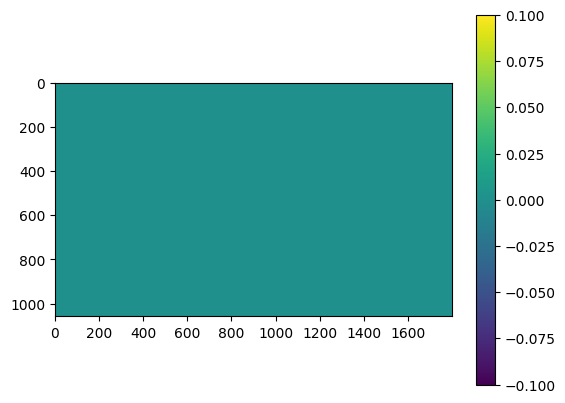

:DLWRF:surface


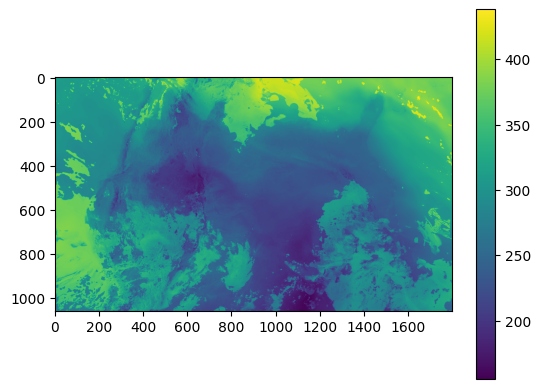

:DPT:2 m above ground
:RH:2 m above ground
:TMP:2 m above ground
:UGRD:10 m above ground
:VGRD:10 m above ground
:UGRD:80 m above ground
:VGRD:80 m above ground
2020 1 1 11


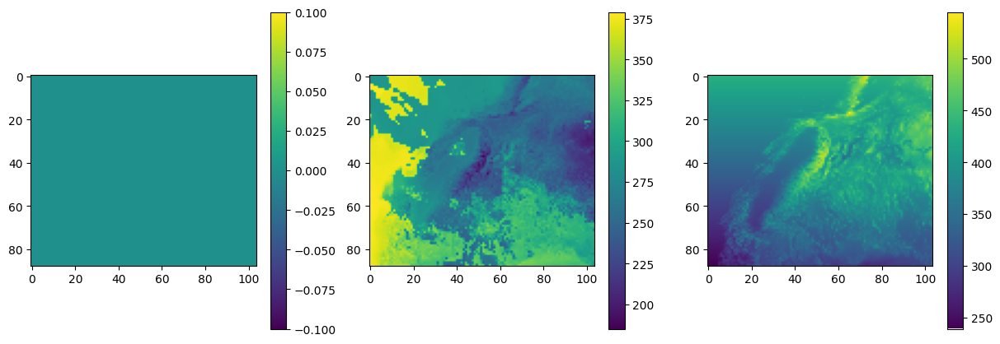

https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t12z.wrfnatf00.grib2
:PRES:surface
:PRATE:surface
:DSWRF:surface


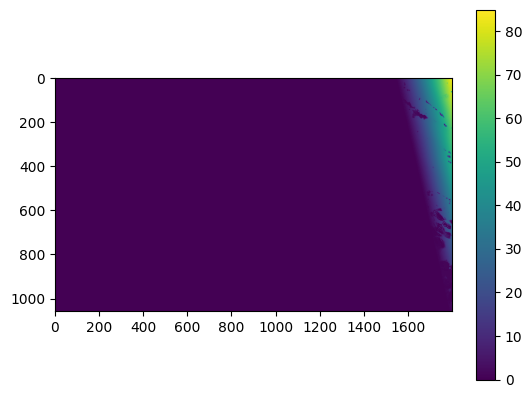

:DLWRF:surface


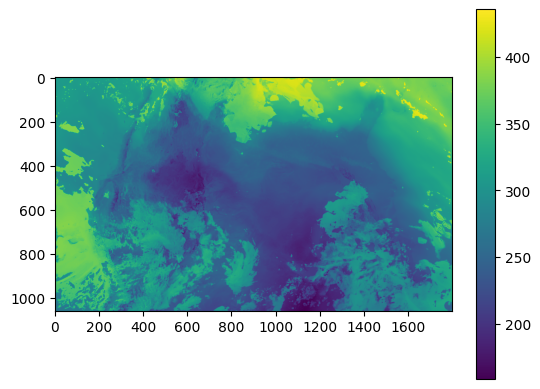

:DPT:2 m above ground
:RH:2 m above ground
:TMP:2 m above ground
:UGRD:10 m above ground
:VGRD:10 m above ground
:UGRD:80 m above ground
:VGRD:80 m above ground
2020 1 1 12


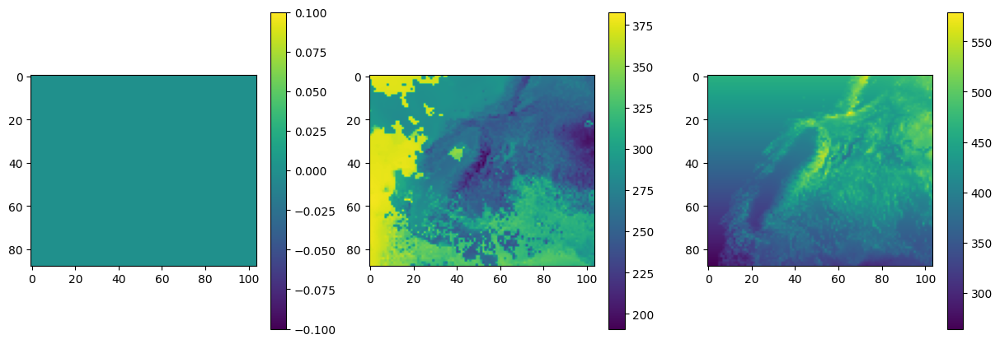

https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t13z.wrfnatf00.grib2
:PRES:surface
:PRATE:surface
:DSWRF:surface


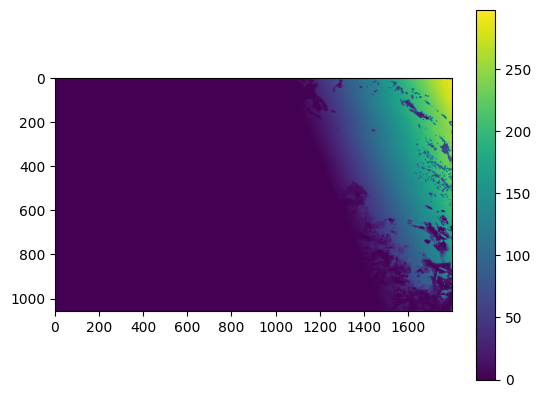

:DLWRF:surface


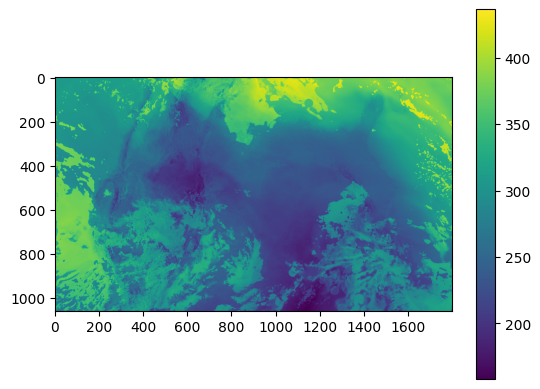

:DPT:2 m above ground
:RH:2 m above ground
:TMP:2 m above ground
:UGRD:10 m above ground
:VGRD:10 m above ground
:UGRD:80 m above ground
:VGRD:80 m above ground
2020 1 1 13


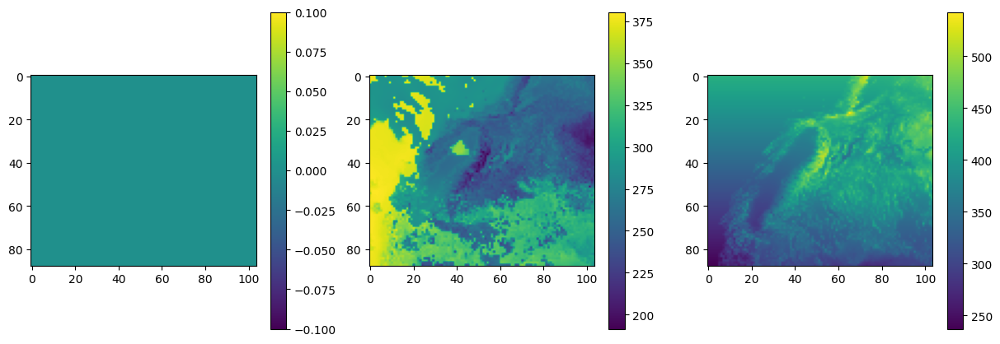

https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t14z.wrfnatf00.grib2
:PRES:surface
:PRATE:surface
:DSWRF:surface


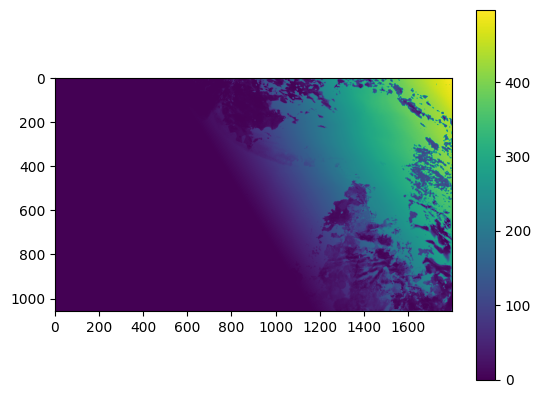

:DLWRF:surface


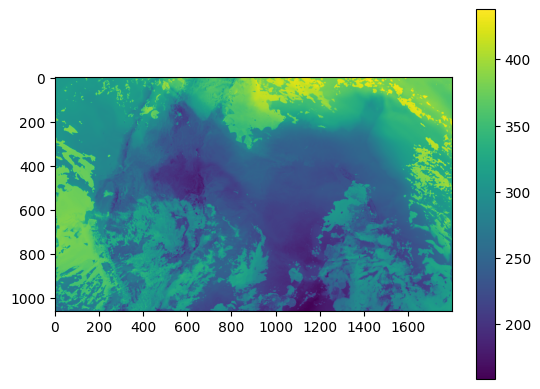

:DPT:2 m above ground
:RH:2 m above ground
:TMP:2 m above ground
:UGRD:10 m above ground
:VGRD:10 m above ground
:UGRD:80 m above ground
:VGRD:80 m above ground
2020 1 1 14


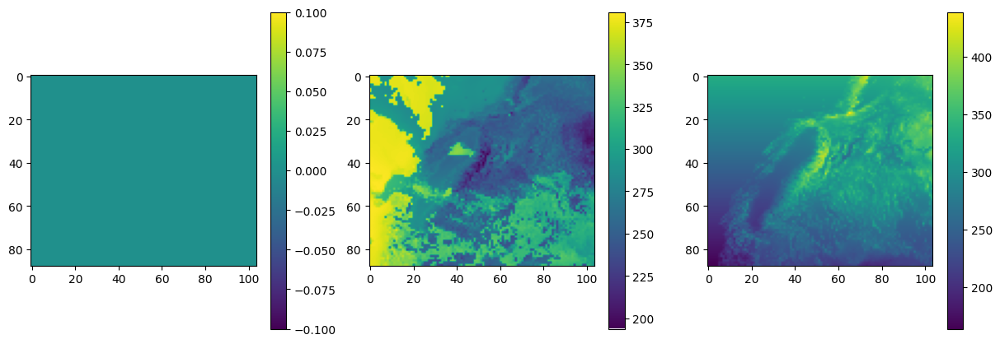

https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t15z.wrfnatf00.grib2
:PRES:surface
:PRATE:surface
:DSWRF:surface


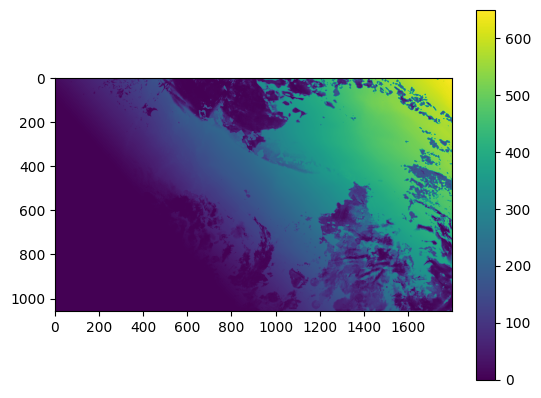

:DLWRF:surface


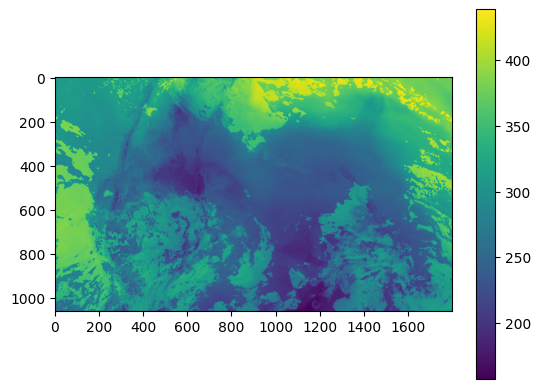

:DPT:2 m above ground
:RH:2 m above ground
:TMP:2 m above ground
:UGRD:10 m above ground
:VGRD:10 m above ground
:UGRD:80 m above ground
:VGRD:80 m above ground
2020 1 1 15


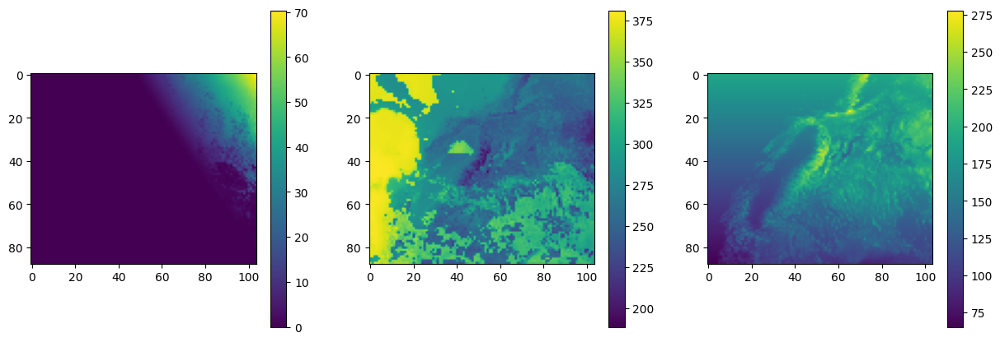

https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t16z.wrfnatf00.grib2
:PRES:surface
:PRATE:surface
:DSWRF:surface


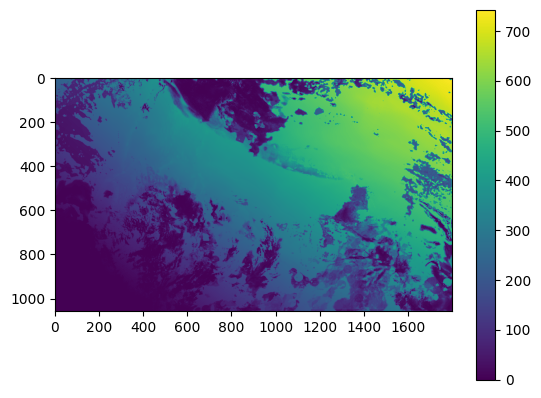

:DLWRF:surface


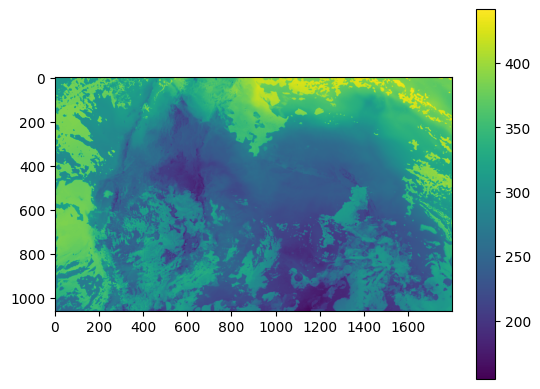

:DPT:2 m above ground
:RH:2 m above ground
:TMP:2 m above ground
:UGRD:10 m above ground
:VGRD:10 m above ground
:UGRD:80 m above ground
:VGRD:80 m above ground
2020 1 1 16


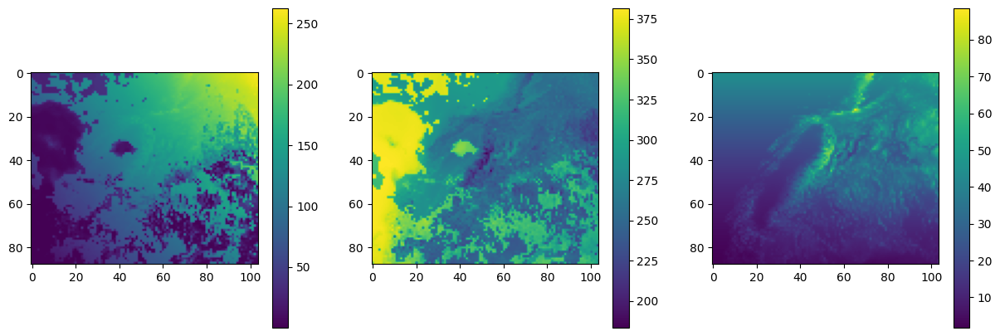

https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t17z.wrfnatf00.grib2
:PRES:surface
:PRATE:surface
:DSWRF:surface


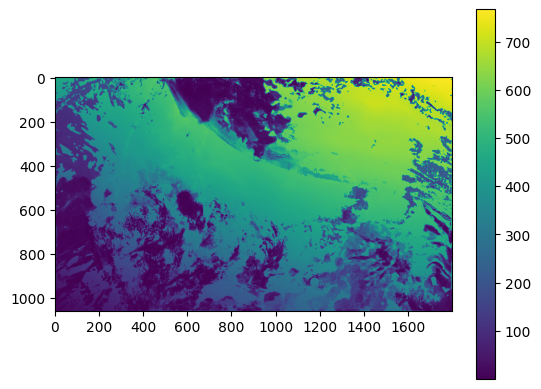

:DLWRF:surface


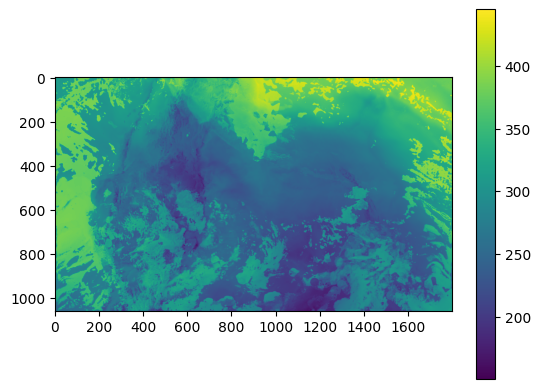

:DPT:2 m above ground
:RH:2 m above ground
:TMP:2 m above ground
:UGRD:10 m above ground
:VGRD:10 m above ground
:UGRD:80 m above ground
:VGRD:80 m above ground
2020 1 1 17


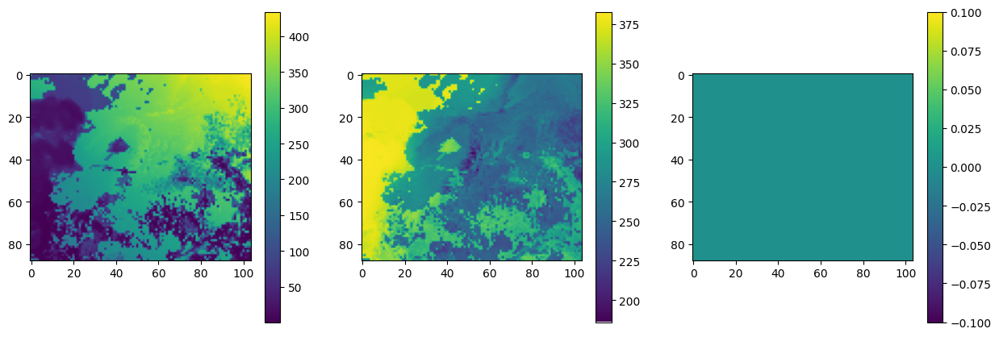

https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t18z.wrfnatf00.grib2
:PRES:surface
:PRATE:surface
:DSWRF:surface


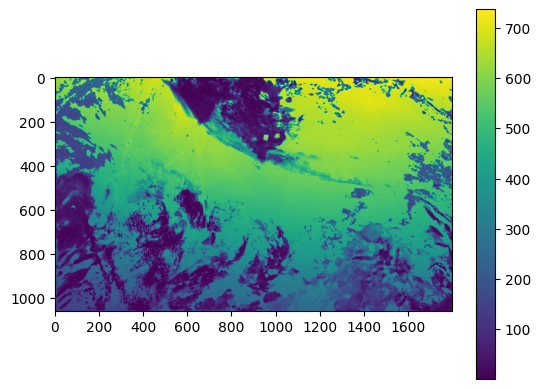

:DLWRF:surface


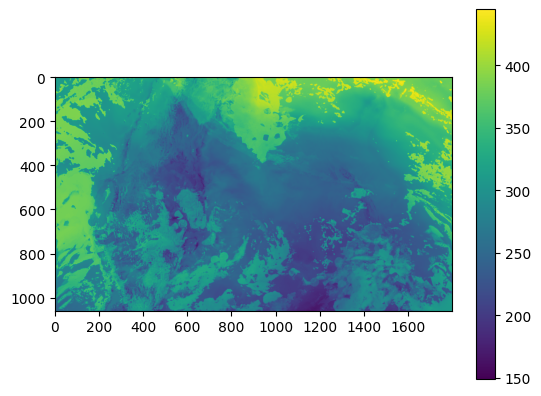

:DPT:2 m above ground
:RH:2 m above ground
:TMP:2 m above ground
:UGRD:10 m above ground
:VGRD:10 m above ground
:UGRD:80 m above ground
:VGRD:80 m above ground
2020 1 1 18


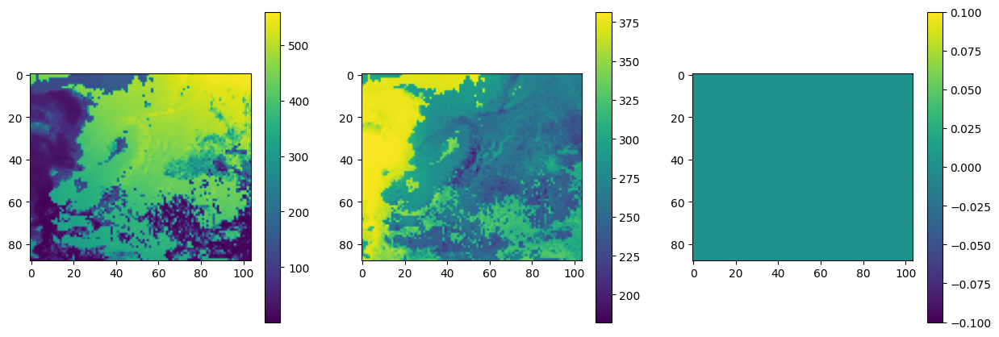

https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t19z.wrfnatf00.grib2
:PRES:surface
:PRATE:surface
:DSWRF:surface


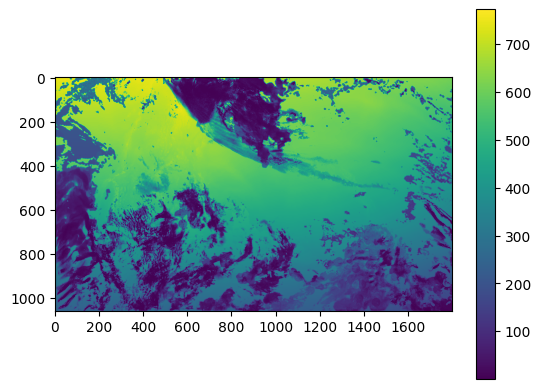

:DLWRF:surface


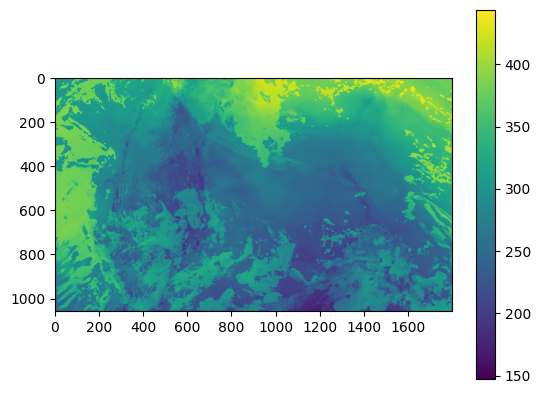

:DPT:2 m above ground
:RH:2 m above ground
:TMP:2 m above ground
:UGRD:10 m above ground
:VGRD:10 m above ground
:UGRD:80 m above ground
:VGRD:80 m above ground
2020 1 1 19


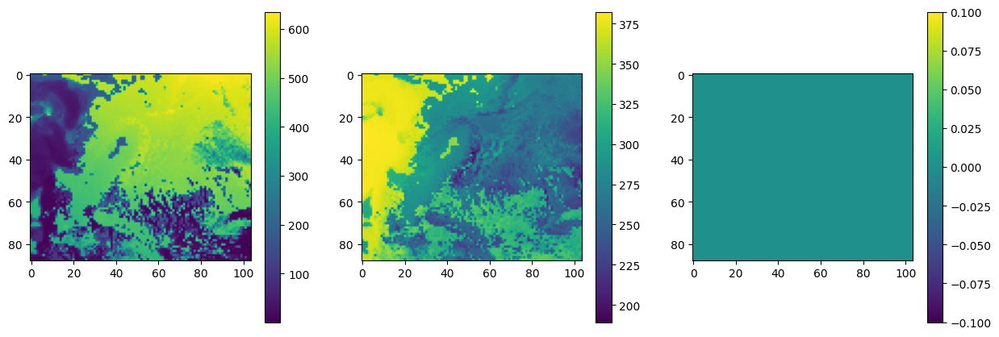

https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t20z.wrfnatf00.grib2
:PRES:surface
:PRATE:surface
:DSWRF:surface


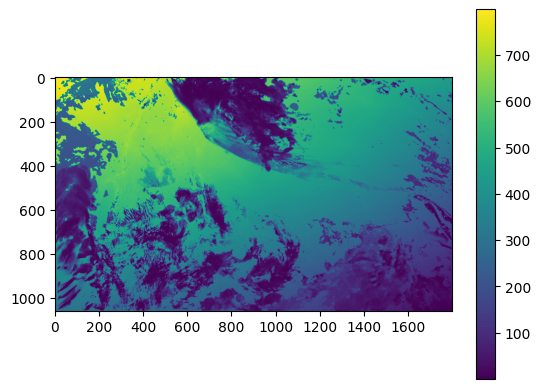

:DLWRF:surface


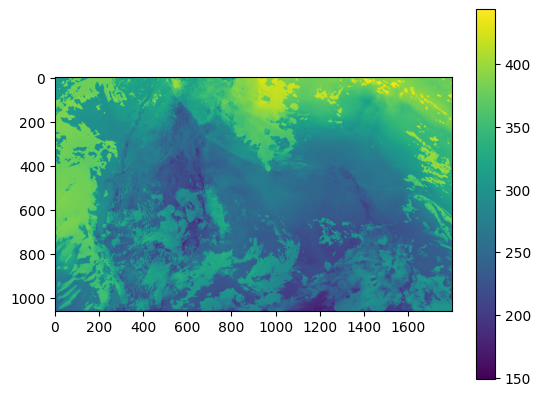

:DPT:2 m above ground
:RH:2 m above ground
:TMP:2 m above ground
:UGRD:10 m above ground
:VGRD:10 m above ground
:UGRD:80 m above ground
:VGRD:80 m above ground
2020 1 1 20


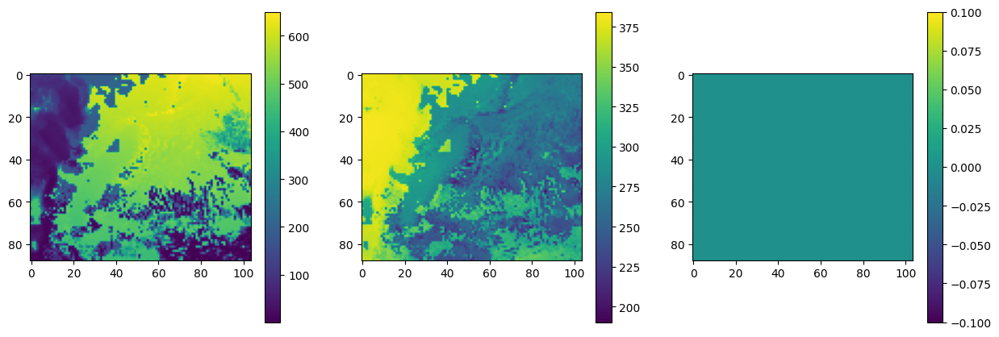

https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t21z.wrfnatf00.grib2
:PRES:surface
:PRATE:surface
:DSWRF:surface


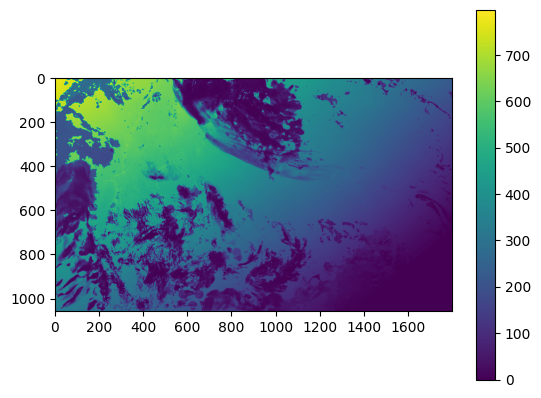

:DLWRF:surface


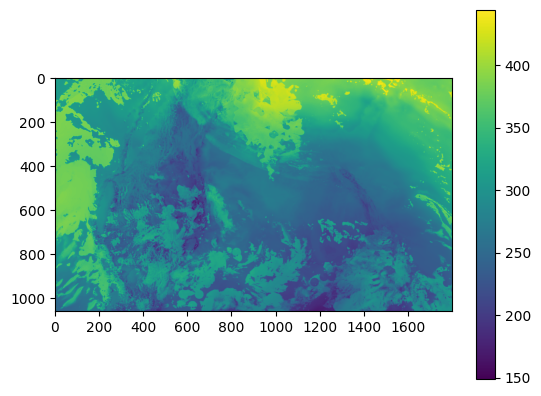

:DPT:2 m above ground
:RH:2 m above ground
:TMP:2 m above ground
:UGRD:10 m above ground
:VGRD:10 m above ground
:UGRD:80 m above ground
:VGRD:80 m above ground
2020 1 1 21


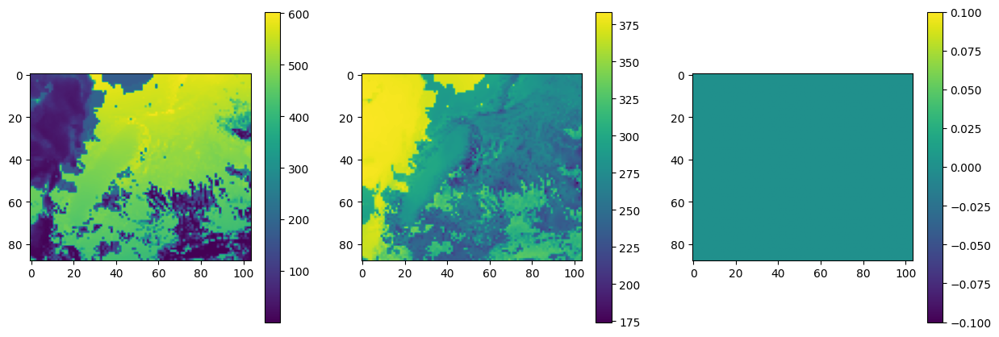

https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t22z.wrfnatf00.grib2
:PRES:surface
:PRATE:surface
:DSWRF:surface


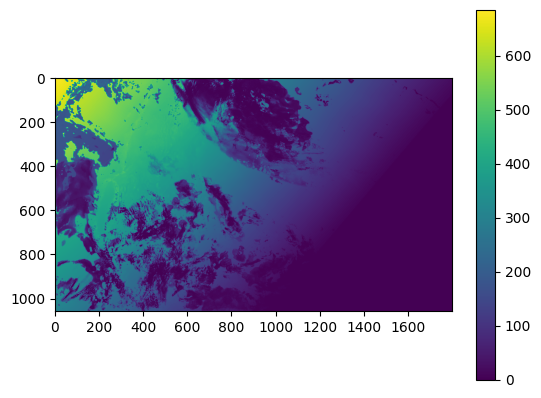

:DLWRF:surface


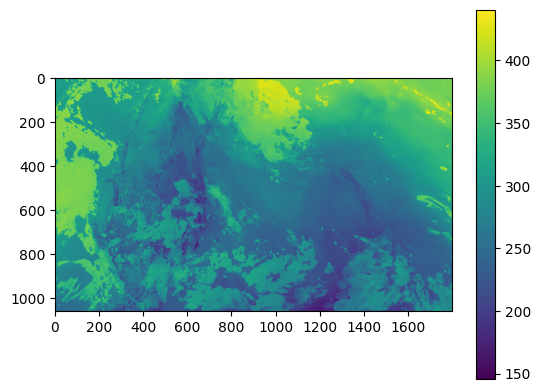

:DPT:2 m above ground
:RH:2 m above ground
:TMP:2 m above ground
:UGRD:10 m above ground
:VGRD:10 m above ground
:UGRD:80 m above ground
:VGRD:80 m above ground
2020 1 1 22


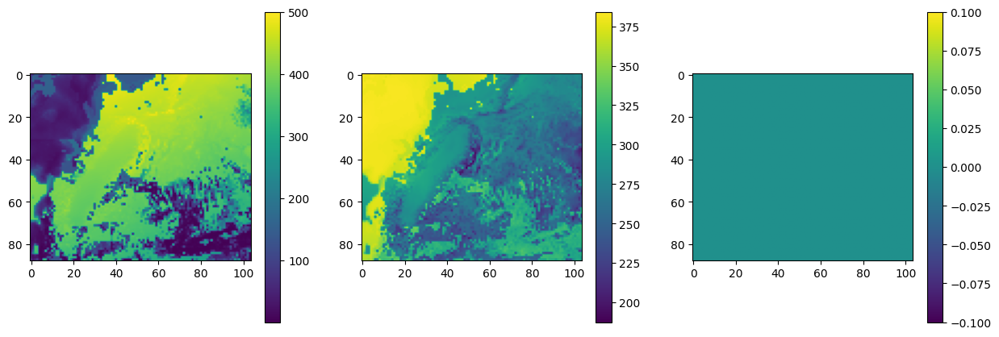

https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t23z.wrfnatf00.grib2
:PRES:surface
:PRATE:surface
:DSWRF:surface


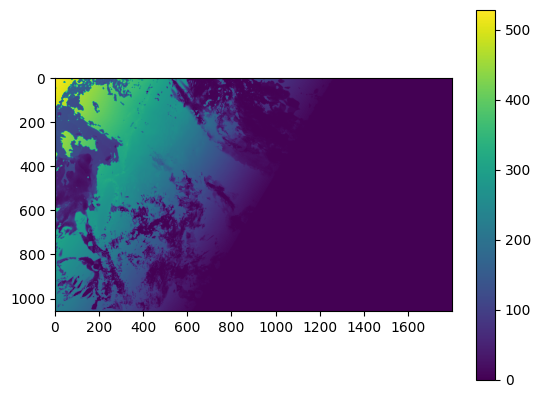

:DLWRF:surface


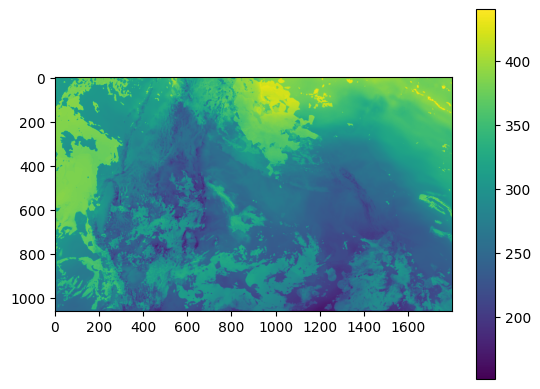

:DPT:2 m above ground
:RH:2 m above ground
:TMP:2 m above ground
:UGRD:10 m above ground
:VGRD:10 m above ground
:UGRD:80 m above ground
:VGRD:80 m above ground
2020 1 1 23


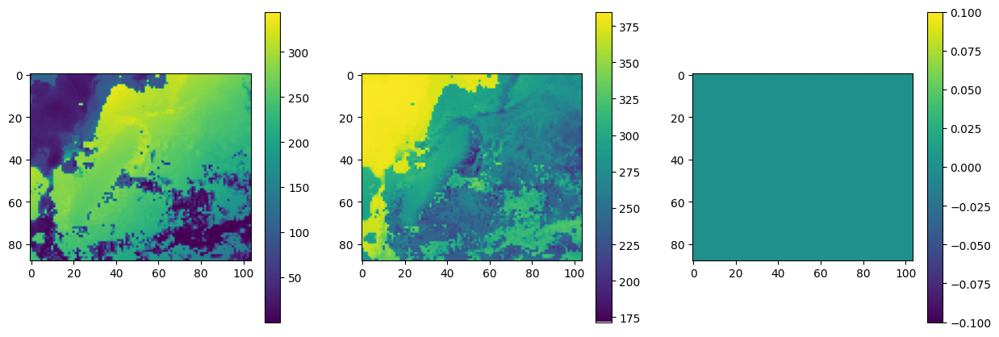

(15, 9152, 13)


In [186]:
# Date 
year  = 2020
month = 1
day   = 1

# Forecast Interval
forecast = 0

data_ = []
for cycle in range(24):
    date = f"{year:02}{month:02}{day:02}"
    
    # Add to list downloaded weather features for given forecasting interval
    X_ = _NOAA_API(keys_, date, cycle, forecast, bucket, sector, product, index_)
    # Get only useful convariates 
    X_prime_ = X_[[0, 1, 2, 3, 4, 5], ...]
    # Get extrapolated wind speed
    M_10_, M_60_, M_80_, M_100_, M_120_ = _extrapolate_wind(X_[7, :], X_[8, :], X_[9, :], X_[10, :])
    # Get wind speedx in matrix form 
    M_ = np.concatenate((M_10_[np.newaxis, ...], 
                         M_60_[np.newaxis, ...], 
                         M_80_[np.newaxis, ...], 
                         M_100_[np.newaxis, ...], 
                         M_120_[np.newaxis, ...]), axis = 0)
    # Get confort metrics
    DI_, WC_, HCDH_ = _confort_metrics(X_[6, :], X_[5, :], M_10_)
    # Get confort metrics in matrix form 
    C_ = np.concatenate((DI_[np.newaxis, ...], 
                         WC_[np.newaxis, ...], 
                         HCDH_[np.newaxis, ...]), axis = 0)
    # Get ideal solar radiation 
    GSI_ = _ideal_solar_radation(h_ref_, W_ref_[:, 1], year, month, day, cycle)
    
    plt.figure(figsize = (15, 5))
    plt.subplot(131)
    plt.imshow(X_prime_[2, ...].reshape(M, N))
    plt.colorbar()
    plt.subplot(132)
    plt.imshow(X_prime_[3, ...].reshape(M, N))
    plt.colorbar()
    plt.subplot(133)
    plt.imshow(GSI_.reshape(M, N))
    plt.colorbar()
    plt.show()
    
    # Save weather features for the h-th hour
    data_ += [np.concatenate((X_prime_, M_, C_, GSI_[np.newaxis, ...]), axis = 0)[..., np.newaxis]]

# Save data with each weather feature for each grid point
data_ = np.concatenate(data_, axis = -1)
print(data_.shape)

pickle_file_name = f"Weather_{date}.pkl"
with open(path_to_oac + pickle_file_name, 'wb') as _f:
    pickle.dump(data_, _f, protocol = pickle.HIGHEST_PROTOCOL)

366
2020-01-01 00:00:00+00:00
2019-12-31 16:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t00z.wrfnatf00.grib2
2019 12 31 16
2019 12 31 16


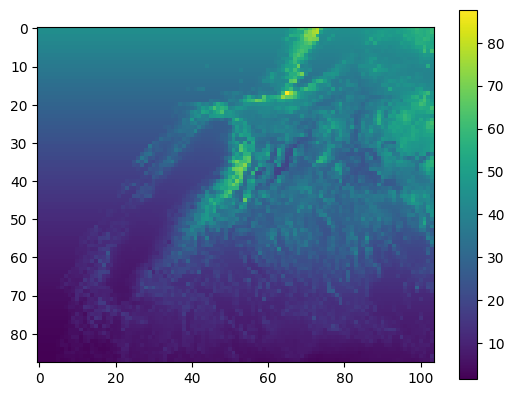

2019-12-31 17:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t01z.wrfnatf00.grib2
2019 12 31 17
2019 12 31 17


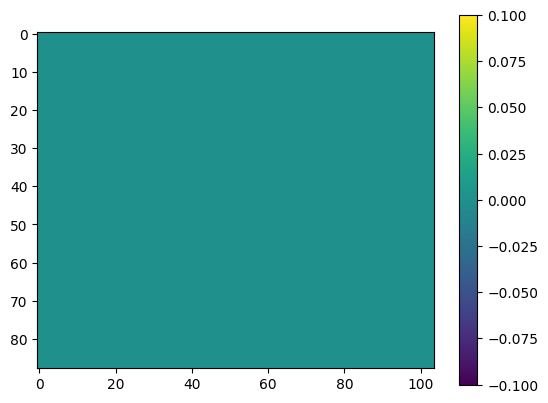

2019-12-31 18:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t02z.wrfnatf00.grib2
2019 12 31 18
2019 12 31 18


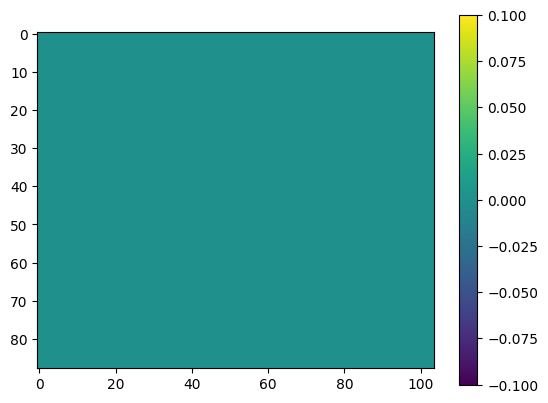

2019-12-31 19:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t03z.wrfnatf00.grib2
2019 12 31 19
2019 12 31 19


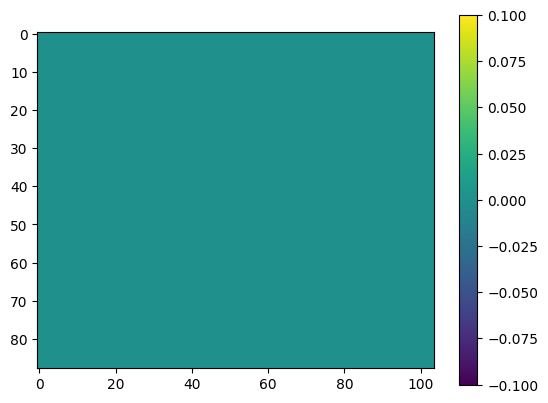

2019-12-31 20:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t04z.wrfnatf00.grib2
2019 12 31 20
2019 12 31 20


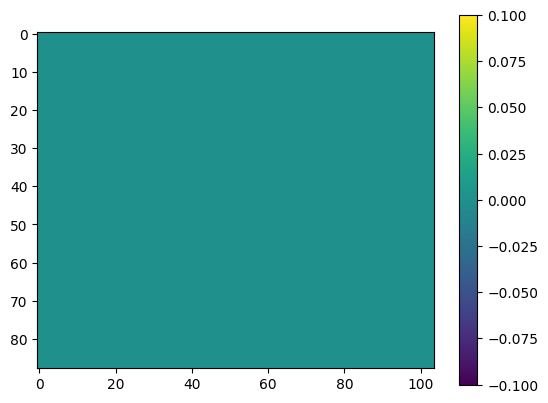

2019-12-31 21:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t05z.wrfnatf00.grib2
2019 12 31 21
2019 12 31 21


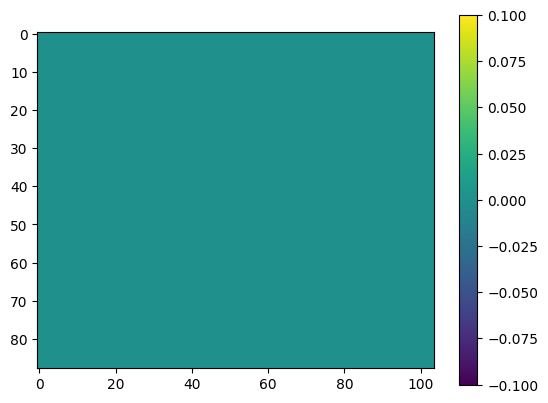

2019-12-31 22:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t06z.wrfnatf00.grib2
2019 12 31 22
2019 12 31 22


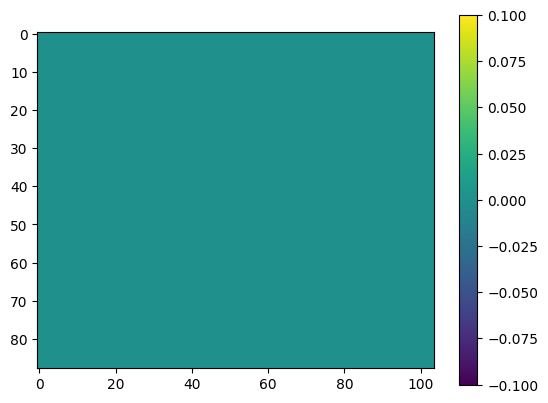

2019-12-31 23:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t07z.wrfnatf00.grib2
2019 12 31 23
2019 12 31 23


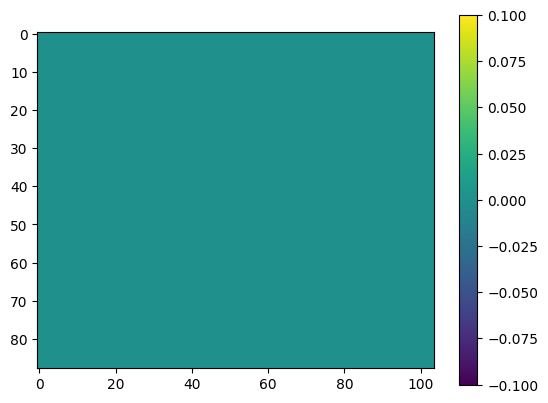

2020-01-01 00:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t08z.wrfnatf00.grib2
2020 1 1 0
2020 1 1 0


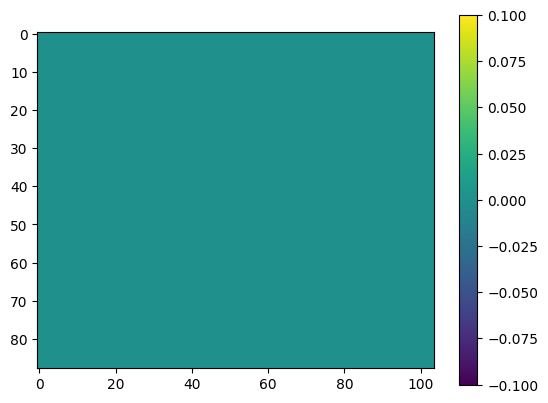

2020-01-01 01:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t09z.wrfnatf00.grib2
2020 1 1 1
2020 1 1 1


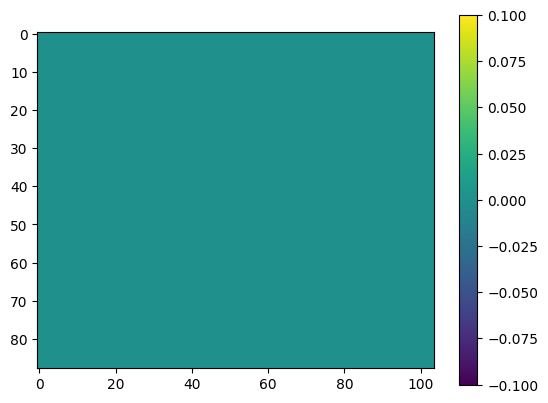

2020-01-01 02:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t10z.wrfnatf00.grib2
2020 1 1 2
2020 1 1 2


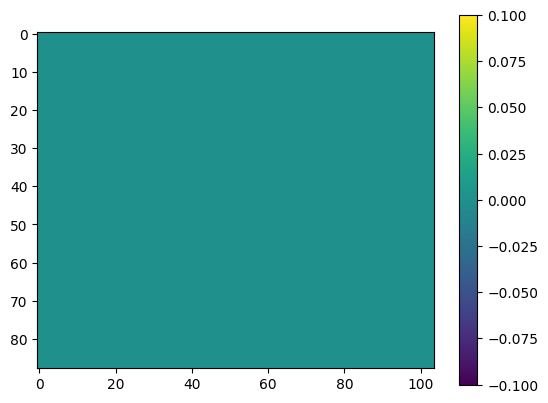

2020-01-01 03:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t11z.wrfnatf00.grib2
2020 1 1 3
2020 1 1 3


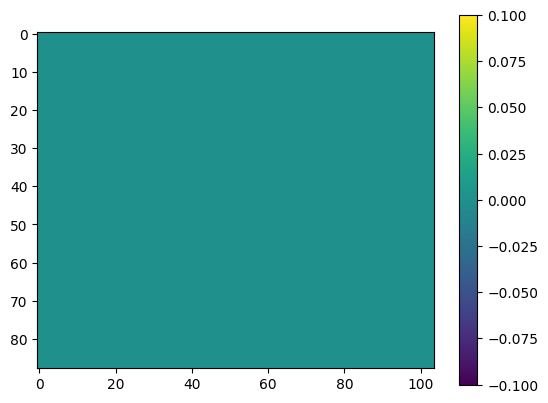

2020-01-01 04:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t12z.wrfnatf00.grib2
2020 1 1 4
2020 1 1 4


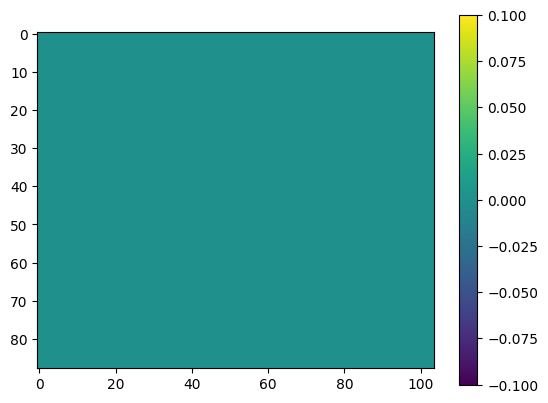

2020-01-01 05:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t13z.wrfnatf00.grib2
2020 1 1 5
2020 1 1 5


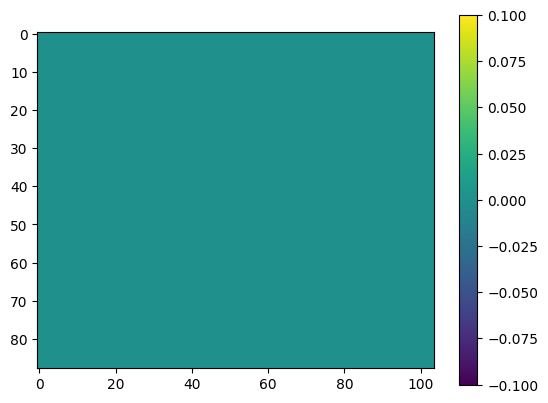

2020-01-01 06:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t14z.wrfnatf00.grib2
2020 1 1 6
2020 1 1 6


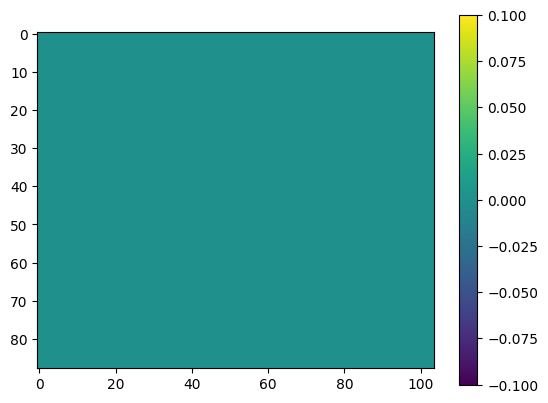

2020-01-01 07:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t15z.wrfnatf00.grib2
2020 1 1 7
2020 1 1 7


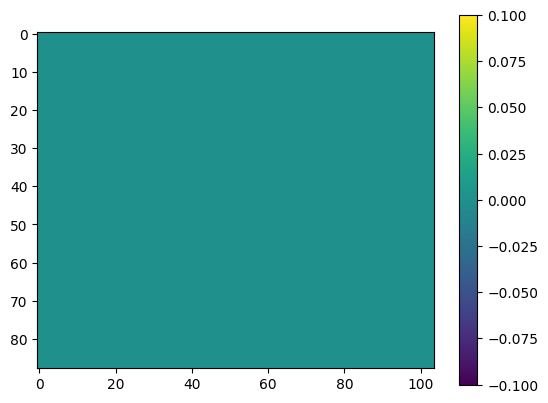

2020-01-01 08:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t16z.wrfnatf00.grib2
2020 1 1 8
2020 1 1 8


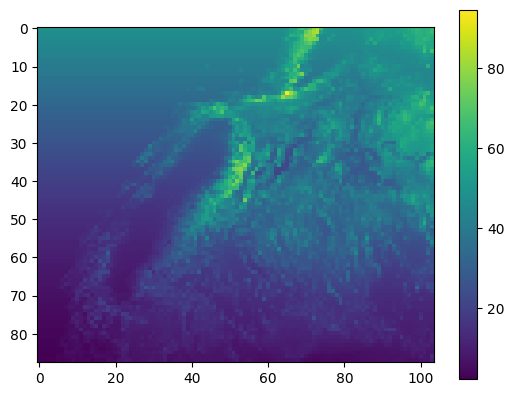

2020-01-01 09:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t17z.wrfnatf00.grib2
2020 1 1 9
2020 1 1 9


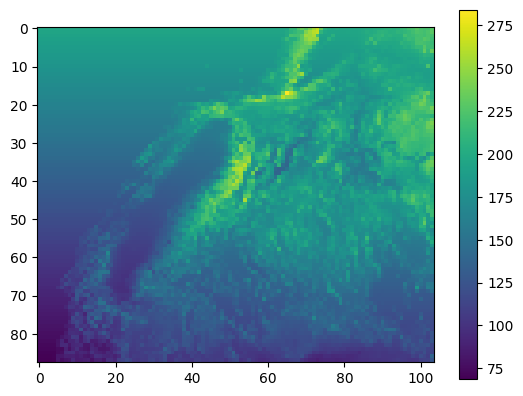

2020-01-01 10:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t18z.wrfnatf00.grib2
2020 1 1 10
2020 1 1 10


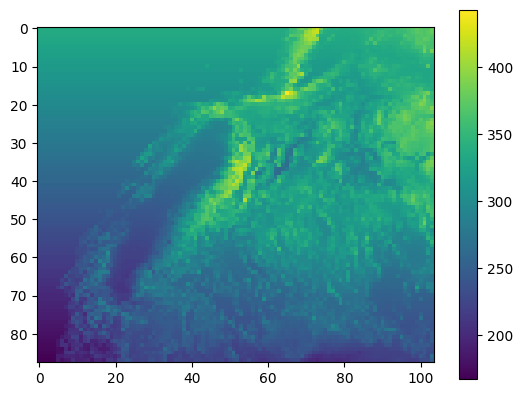

2020-01-01 11:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t19z.wrfnatf00.grib2
2020 1 1 11
2020 1 1 11


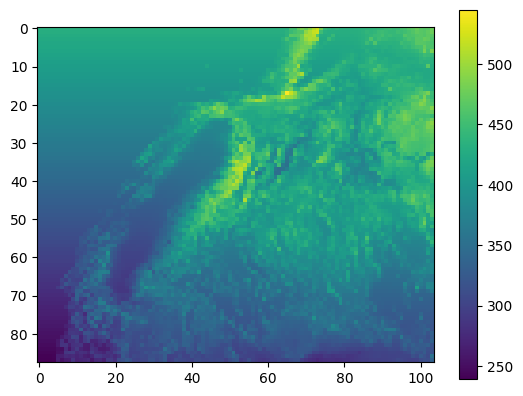

2020-01-01 12:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t20z.wrfnatf00.grib2
2020 1 1 12
2020 1 1 12


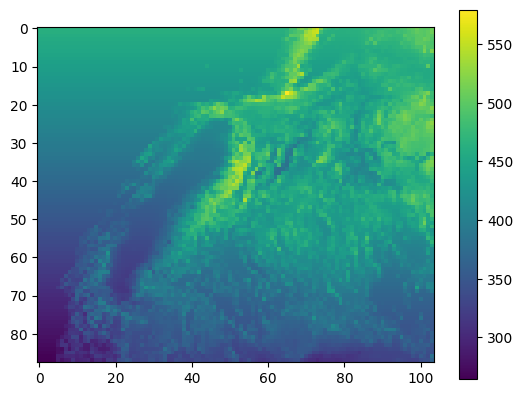

2020-01-01 13:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t21z.wrfnatf00.grib2
2020 1 1 13
2020 1 1 13


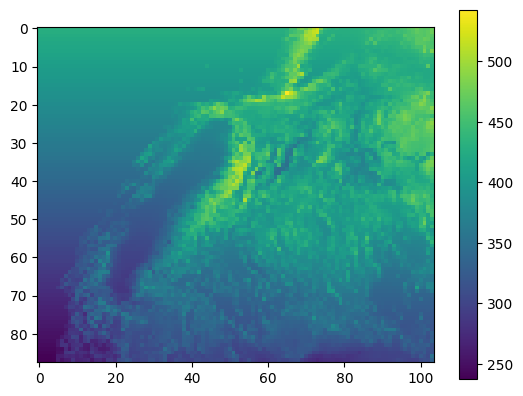

2020-01-01 14:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t22z.wrfnatf00.grib2
2020 1 1 14
2020 1 1 14


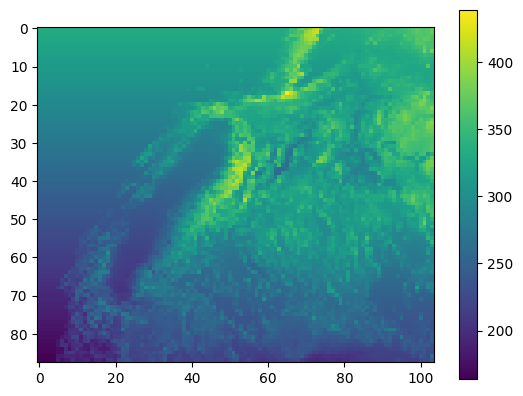

2020-01-01 15:00:00-08:00
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t23z.wrfnatf00.grib2



KeyboardInterrupt



In [25]:
year = 2020

# Forecast Interval
forecast = 0

# Retrive a year long data
_start_date = datetime(year, 1, 1)
_end_date   = datetime(year + 1, 1, 1)
N_days      = (_end_date - _start_date).days
print(N_days)

# Defining the timezone
_utc = pytz.timezone('UTC')
_ptz = pytz.timezone('America/Los_Angeles')

# Get daylong data request
_delta = timedelta(days = 1/24)

# Define date in is corresponding timezone
_utc_date = _utc.localize(_start_date)
print(_utc_date)

# Loop over number of days
for i in range(N_days):

    # Get date in API request format
    time = f"{_start_date.year:02}{_start_date.month:02}{_start_date.day:02}"
    
    data_ = []
    for cycle in range(24):
        #date = f"{year:02}{month:02}{day:02}"
    
        # Check time difference between time zones
        _ptz_date = _utc_date.astimezone(_ptz)
        print(_ptz_date)

        # Add to list downloaded weather features for given forecasting interval
        X_ = _NOAA_API(keys_, time, cycle, forecast, bucket, sector, product, index_)
        # Get only useful convariates 
        X_prime_ = X_[[0, 1, 2, 3, 4, 5], ...]
        # Get extrapolated wind speed
        M_10_, M_60_, M_80_, M_100_, M_120_ = _extrapolate_wind(X_[7, :], X_[8, :], X_[9, :], X_[10, :])
        # Get wind speedx in matrix form 
        M_ = np.concatenate((M_10_[np.newaxis, ...], 
                             M_60_[np.newaxis, ...], 
                             M_80_[np.newaxis, ...], 
                             M_100_[np.newaxis, ...], 
                             M_120_[np.newaxis, ...]), axis = 0)
        # Get confort metrics
        DI_, WC_, HCDH_ = _confort_metrics(X_[6, :], X_[5, :], M_10_)
        # Get confort metrics in matrix form 
        C_ = np.concatenate((DI_[np.newaxis, ...], 
                             WC_[np.newaxis, ...], 
                             HCDH_[np.newaxis, ...]), axis = 0)
        
        print(_ptz_date.year, _ptz_date.month, _ptz_date.day, _ptz_date.hour)

        # Get ideal solar radiation 
        GSI_ = _ideal_solar_radation(h_ref_, W_ref_[:, 1], _ptz_date.year, _ptz_date.month, _ptz_date.day, _ptz_date.hour)
        
        plt.figure()
        plt.imshow(GSI_.reshape(M, N))
        plt.colorbar()
        plt.show()
    
        # Save weather features for the h-th hour
        data_ += [np.concatenate((X_prime_, M_, C_, GSI_[np.newaxis, ...]), axis = 0)[..., np.newaxis]]

        # Got to next day
        _utc_date += _delta
    break
    # Save data with each weather feature for each grid point
    data_ = np.concatenate(data_, axis = -1)
    print(data_.shape)

    pickle_file_name = f"Weather_{time}.pkl"
    with open(path_to_oac + pickle_file_name, 'wb') as _f:
        pickle.dump(data_, _f, protocol = pickle.HIGHEST_PROTOCOL)
    
    # # Got to next day
    # _start_date += _delta

366
https://storage.googleapis.com/high-resolution-rapid-refresh/hrrr.20200101/conus/hrrr.t00z.wrfnatf00.grib2
:PRES:surface
(1059, 1799) (1905141,) (1905141,)
:PRATE:surface
(1059, 1799) (1905141,) (1905141,)
:DSWRF:surface
(1059, 1799) (1905141,) (1905141,)


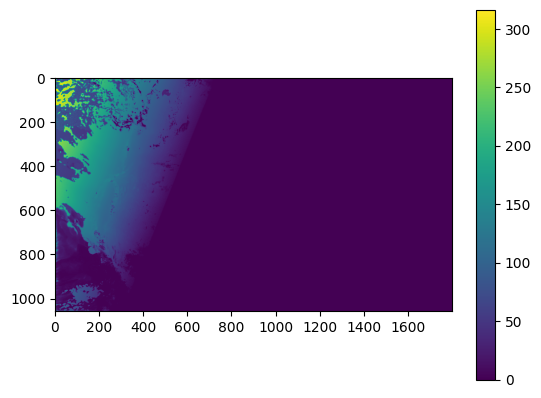

:DLWRF:surface
(1059, 1799) (1905141,) (1905141,)


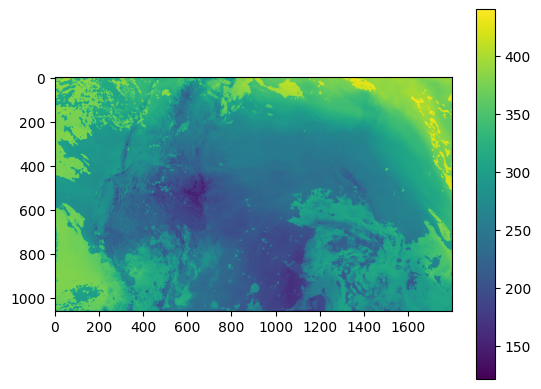

:DPT:2 m above ground


KeyboardInterrupt: 

In [7]:
year = 2020

# Forecast Interval
forecast = 0

# Set configuration to retrive forecast or actuals
if forecast == 0:
    cycle_    = np.arange(0, 24, 1, dtype = int)
    forecast_ = [0]
else:
    cycle_    = [0, 6, 12, 18]
    forecast_ = np.arange(1, 49, 1, dtype = int)

# Retrive a year long data
_start_date = date(year, 1, 1)
_end_date   = date(year + 1, 1, 1)
N_days      = (_end_date - _start_date).days
print(N_days)

# Get daylong data request
_delta = timedelta(days = 1)

# Loop over number of days
for i in range(N_days):

    # Get date in API request format
    date = f"{_start_date.year:02}{_start_date.month:02}{_start_date.day:02}"
    
    data_prime_ = []
    # Loop over hours
    for cycle in cycle_:
        
        data_ = []
        # Loop over forecasting horizons
        for forecast in forecast_:
            
            # Add to list downloaded weather features for given forecasting interval
            X_ = _NOAA_API(keys_, date, cycle, forecast, bucket, sector, product, index_)
            # Get only useful convariates 
            X_prime_ = X_[[0, 2, 3, 4, 5], ...]
            # Get extrapolated wind speed
            M_10_, M_60_, M_80_, M_100_, M_120_ = _extrapolate_wind(X_[7, :], X_[8, :], X_[9, :], X_[10, :])
            # Get wind speedx in matrix form 
            M_ = np.concatenate((M_10_[np.newaxis, ...], 
                                 M_60_[np.newaxis, ...], 
                                 M_80_[np.newaxis, ...], 
                                 M_100_[np.newaxis, ...], 
                                 M_120_[np.newaxis, ...]), axis = 0)
            # Get confort metrics
            DI_, WC_, HCDH_ = _confort_metrics(X_[6, :], X_[5, :], M_10_)
            # Get confort metrics in matrix form 
            C_ = np.concatenate((DI_[np.newaxis, ...], 
                                 WC_[np.newaxis, ...], 
                                 HCDH_[np.newaxis, ...]), axis = 0)
            # Get ideal solar radiation 
            GSI_ = _ideal_solar_radation(h_ref_, W_ref_[:, 1], year, month, day, cycle)
            # Save weather features for the h-th hour
            data_ += [np.concatenate((X_prime_, M_, C_, GSI_[np.newaxis, ...]), axis = 0)[..., np.newaxis]]

        # Save data with each weather feature for each grid point and each forecasting horizon
        data_prime_ += [np.concatenate(data_, axis = -1)[np.newaxis, ...]]

    # Save data with each weather feature for each grid point, each forecasting horizon, and cycle
    data_prime_ = np.concatenate(data_prime_, axis = -1)
    print(data_prime_.shape)
        
    pickle_file_name = f"Weather_{date}.pkl"
    with open(path_to_oac + pickle_file_name, 'wb') as _f:
        pickle.dump(data_prime_, _f, protocol = pickle.HIGHEST_PROTOCOL)

    # Got to next day
    _start_date += _delta

# Consolidate Data After Downloading

Get Index Names:
* NOAA Weather: 
    * **Weather features:** PRES (surface), PRATE (surface), DSWRF (surface), DLWRF (surface), DPT (2m), RH (2m), TMP (2m), UGRD (10m), VGRD (10m), UGRD (80m), VGRD (80m). 
    * **Wind features derived with Power Law:** WS (10m), WS (60m), WS (80m), WS (100m), WS (120m).
    * **Derived from weather features:** DI (2m), WC (2m), HCDH (2m).
    * **Theoretical weather features:** GSI (surface).
        * *Indexes: [0:PRES (surface), 1:PRATE (surface), 2:DSWRF (surface), 3:DLWRF (surface), 4:DPT (2m), 5:RH (2m), 6:TMP (2m), 7:WS (10m), 8:WS (60m), 9:WS (80m), 10:WS (100m), 11:WS (120m), 12:DI (2m), 13:WC (2m), 14:HCDH (2m), 15:GSI (surface)]*

* CAISO Electricity:
    * **Energy demand:** CA ISO-TAC, MWD-TAC, PGE-TAC, SCE-TAC, SDGE-TAC, VEA-TAC
    * **Solar energy generation:** NP15, SP15, ZP26.
    * **Wind energy generation:** NP15, SP15.
        * *Indexes: [0:CA ISO-TAC, 1:MWD-TAC, 2:PGE-TAC, 3:SCE-TAC, 4:SDGE-TAC, 5:VEA-TAC, 6:S-NP15, 7:S-SP15, 8:S-ZP26, 9:W-NP15, 10:W-SP15]*


(24, 1, 15, 9152) (1, 16, 9152, 36)
10


/var/folders/0c/ffx2kgyn7xq4krqrpsv67l3m0000gn/T/ipykernel_78628/3400188845.py:64: RuntimeWarning: invalid value encountered in true_divide
  plt.imshow(np.reshape(I_dir_, (M, N))/np.reshape(I_teo_, (M, N)))


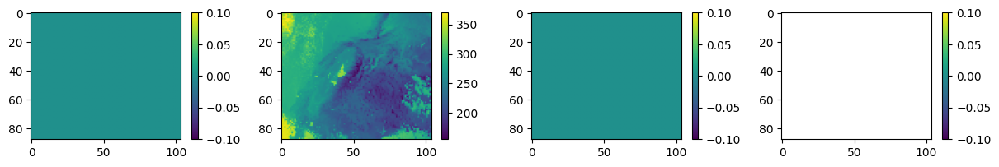

11


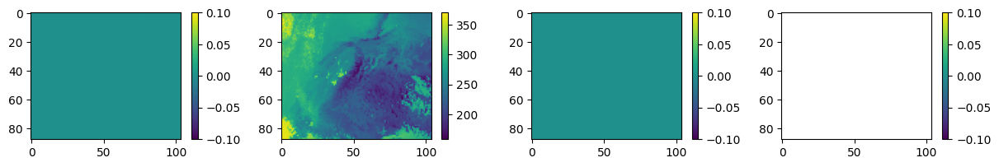

12


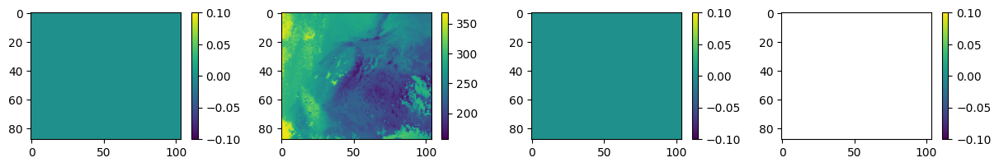

13


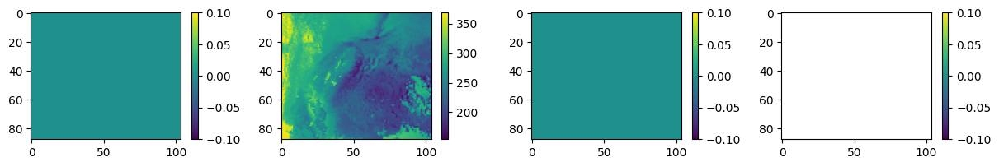

14


/var/folders/0c/ffx2kgyn7xq4krqrpsv67l3m0000gn/T/ipykernel_78628/3400188845.py:64: RuntimeWarning: divide by zero encountered in true_divide
  plt.imshow(np.reshape(I_dir_, (M, N))/np.reshape(I_teo_, (M, N)))


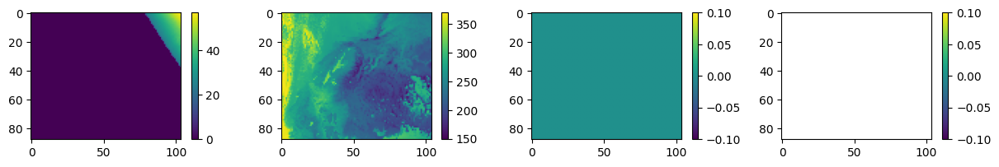

15


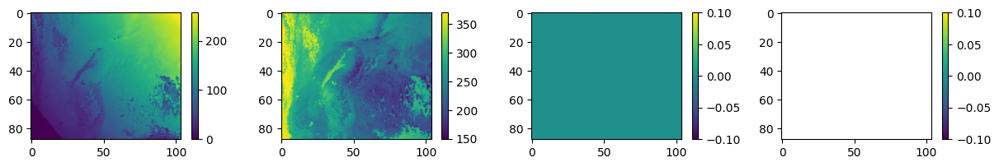

16


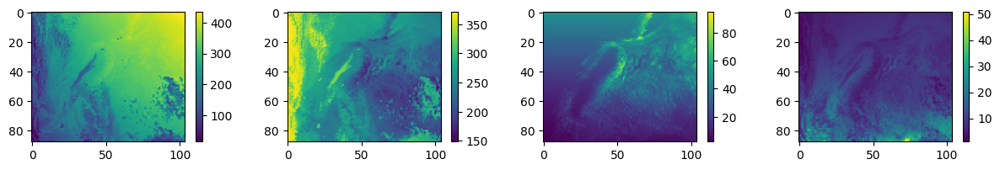

17


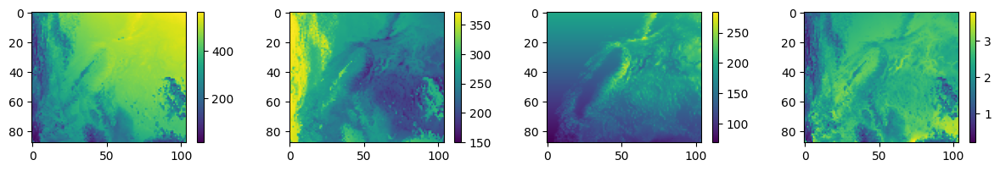

18


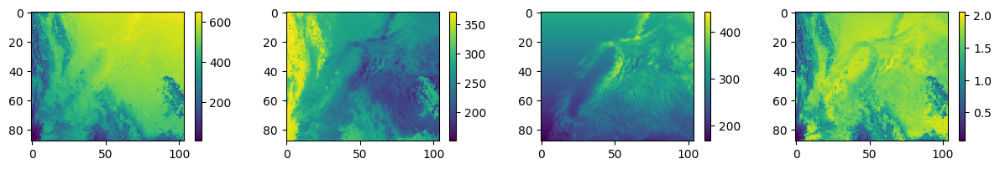

19


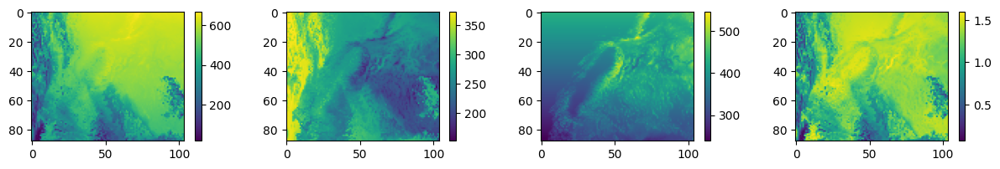

20


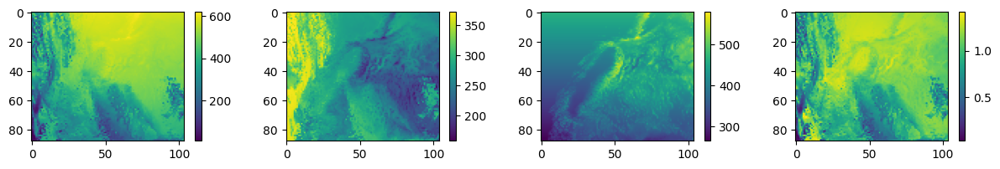

21


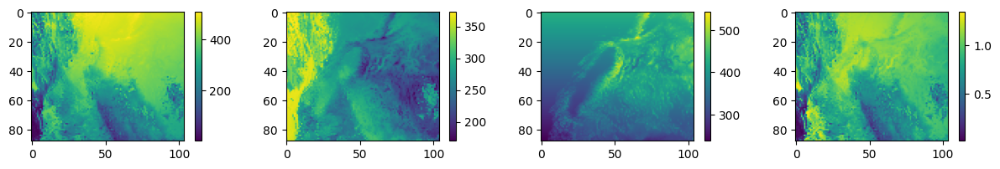

22


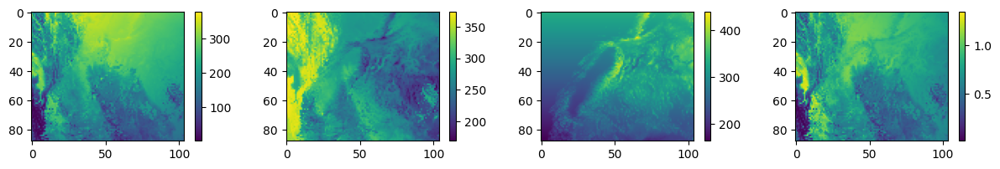

23


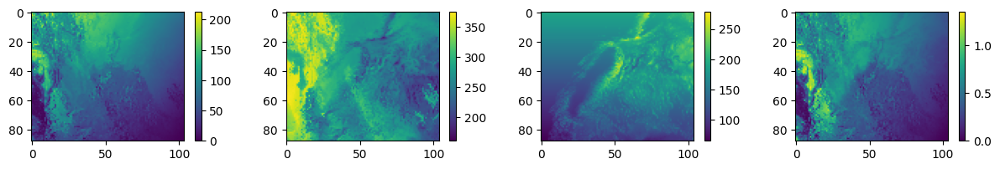

24


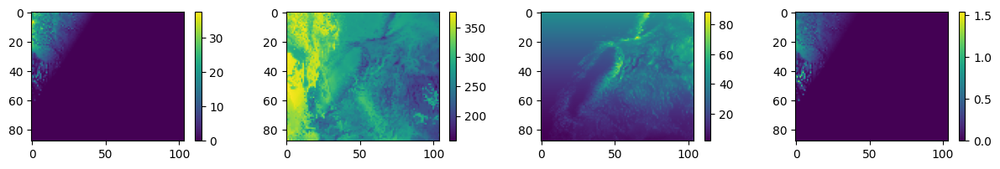

25


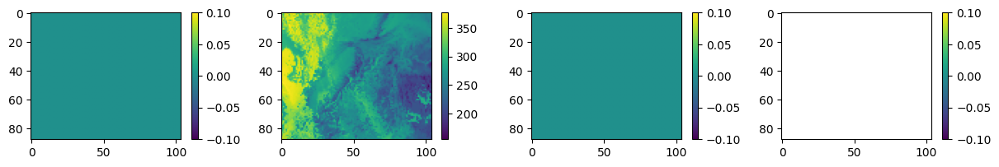

26


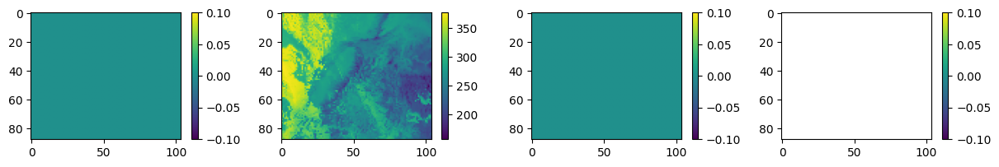

27


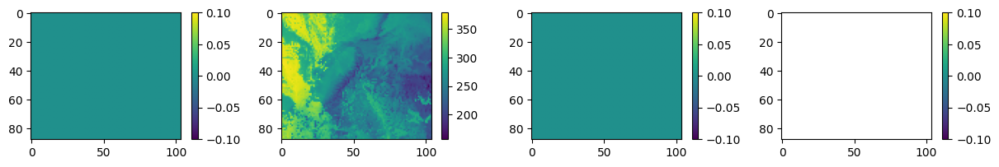

28


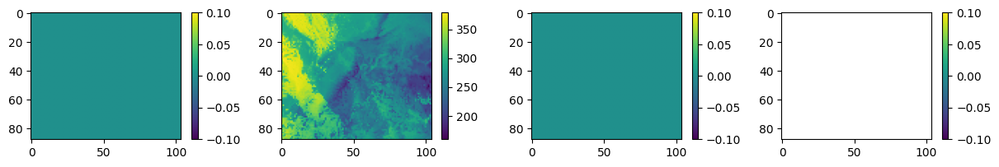

29


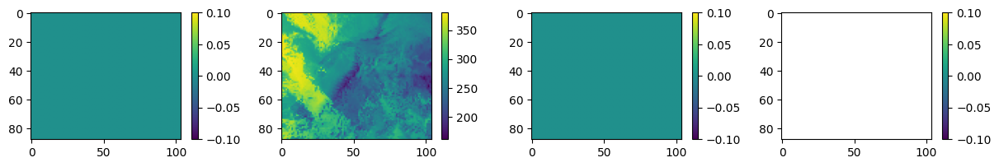

30


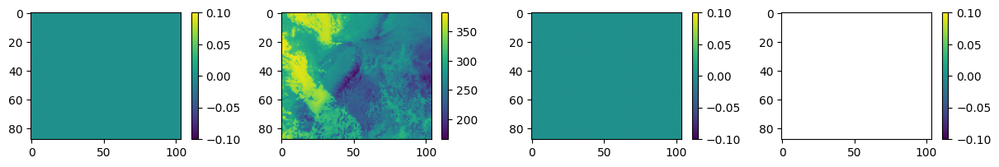

31


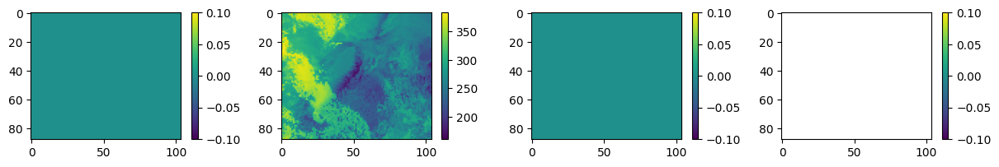

32


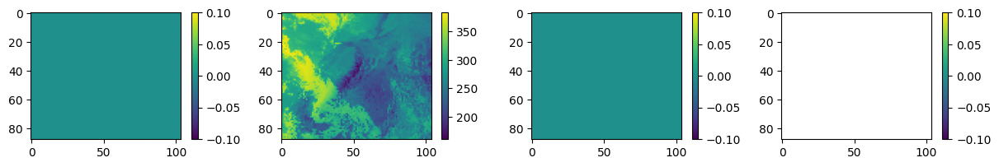

33


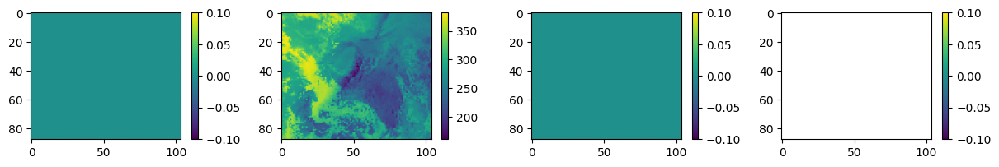

34


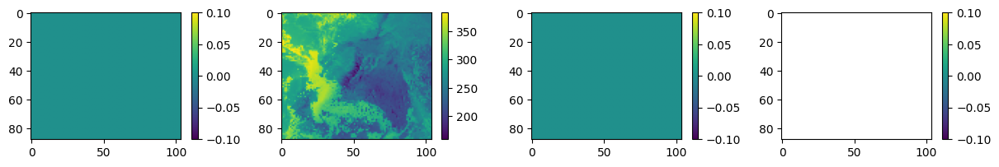

35


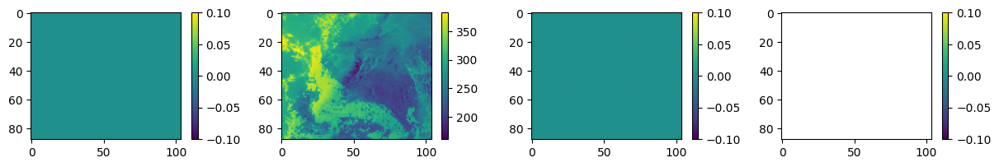

In [111]:
year = 2021

forecasts = 0

# Retrive a year long data
_start_date = date(year, 1, 1)

# Define path to files
paths_ = [path_to_oac, path_to_oac, path_to_ofc][forecasts]

# Get date in API request format
time = f"{_start_date.year:02}{_start_date.month:02}{_start_date.day:02}"
        
# Load Weather Data
pickle_file_name = path_to_oac + f"Weather_{time}.pkl"
with open(pickle_file_name, 'rb') as _f:
    ac_ = pickle.load(_f)

# Load Weather Data
pickle_file_name = path_to_ofc + f"Weather_{time}-00.pkl"
with open(pickle_file_name, 'rb') as _f:
    fc_ = pickle.load(_f)
    
print(ac_.shape, fc_.shape)

# for i in range(ac_.shape[0]):
#     I_dir_ = ac_[i, 0, 1, :]
#     I_dif_ = ac_[i, 0, 2, :]
#     I_teo_ = ac_[i, 0, -1, :]
#     print(i)
    
#     plt.figure(figsize = (15, 3))
#     plt.subplot(141)
#     plt.imshow(np.reshape(I_dir_, (M, N)))
#     plt.colorbar()
#     plt.subplot(142)
#     plt.imshow(np.reshape(I_dif_, (M, N)))
#     plt.colorbar()
#     plt.subplot(143)
#     plt.imshow(np.reshape(I_teo_, (M, N)))
#     plt.colorbar()
#     plt.subplot(144)
#     plt.imshow(np.reshape(I_dir_, (M, N))/np.reshape(I_teo_, (M, N)))
#     plt.colorbar()
#     plt.show()
    
for i in range(10, fc_.shape[-1]):
    I_dir_ = fc_[0, 2, :, i]
    I_dif_ = fc_[0, 3, :, i]
    I_teo_ = fc_[0, -1, :, i]
    print(i)
    
    plt.figure(figsize = (15, 2))
    plt.subplot(141)
    plt.imshow(np.reshape(I_dir_, (M, N)))
    plt.colorbar()
    plt.subplot(142)
    plt.imshow(np.reshape(I_dif_, (M, N)))
    plt.colorbar()
    plt.subplot(143)
    plt.imshow(np.reshape(I_teo_, (M, N)))
    plt.colorbar()
    plt.subplot(144)
    plt.imshow(np.reshape(I_dir_, (M, N))/np.reshape(I_teo_, (M, N)))
    plt.colorbar()
    plt.show()

In [10]:
import time
time_ = time.localtime()
print(time_.tm_isdst)

# Retrive a year long data
_start_date = datetime(2022, 1, 12)
# Defining the timezone
_ptz = pytz.timezone('America/Los_Angeles')
# Define date in is corresponding timezone
_utc_date = _ptz.localize(_start_date)
print(_utc_date.timetuple().tm_isdst)

1
0


20210301
20210302
20210303
20210304
20210305
20210306
20210307
20210308
20210309
20210310
20210311
20210312
20210313
20210314
20210315
-8 -7
2021-03-15 00:00:00+00:00 2021-03-14 17:00:00-07:00
(312, 10) (312, 10) (312, 15, 9152) (312, 16, 9152)
(311, 9152) (1, 9152)
(312, 15, 9152) (312, 9152)
(312, 9152) (312, 16, 9152)
[2021    2   28   59    0    6    1    0]
[2021    3   13   72   23    5    1    0]
[2021    3    1   60    0    0    0    0]
[2021    3   13   72   23    5    1    0]


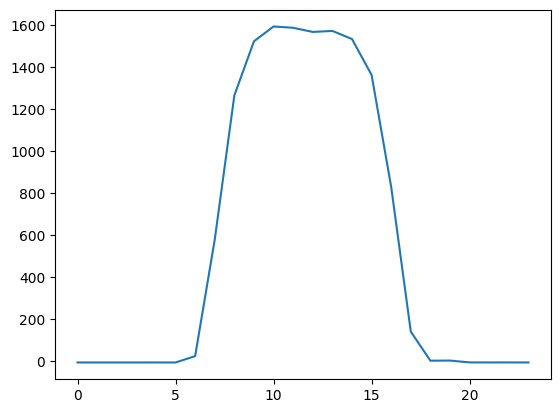

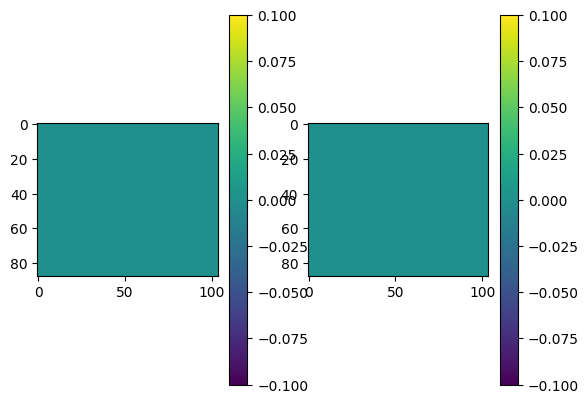

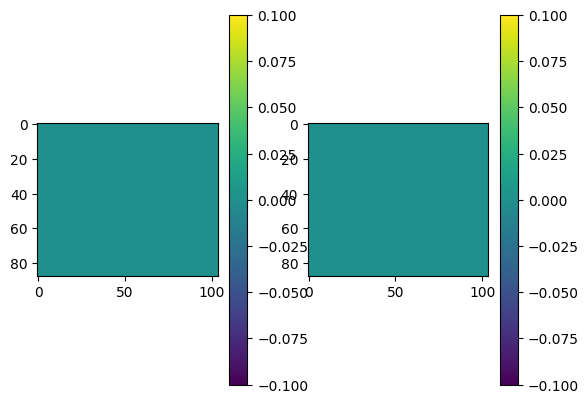

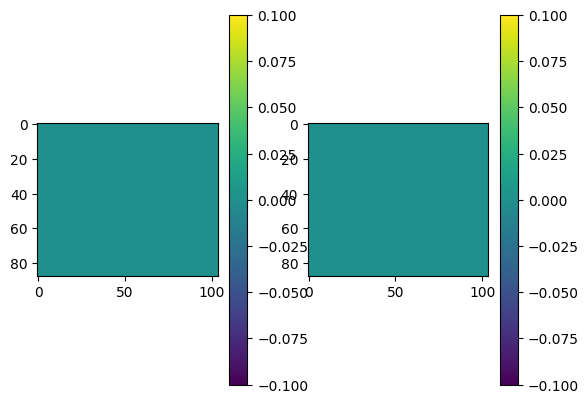

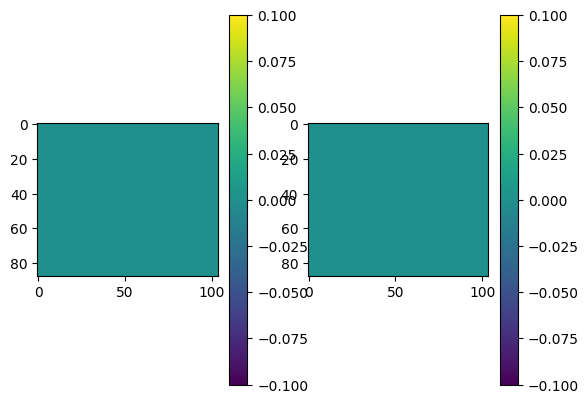

...

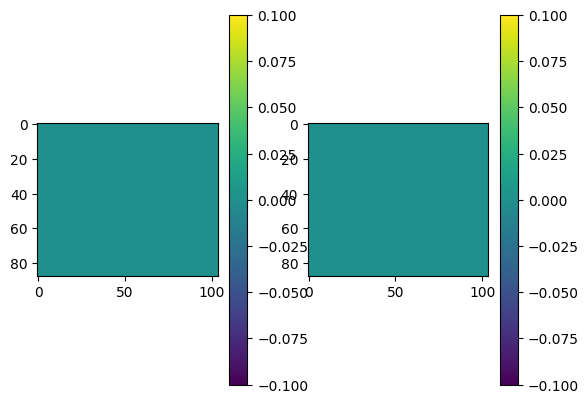

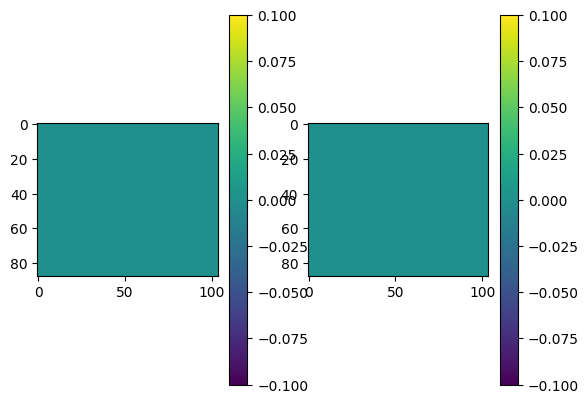

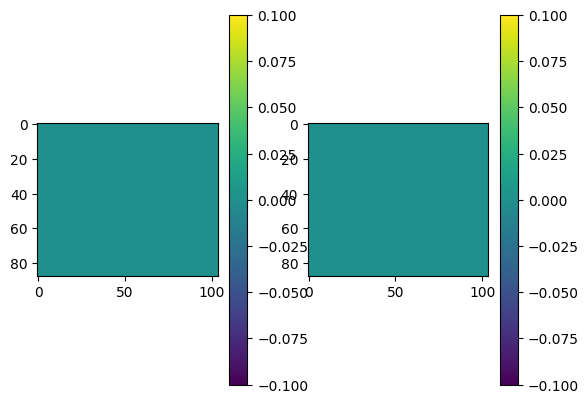

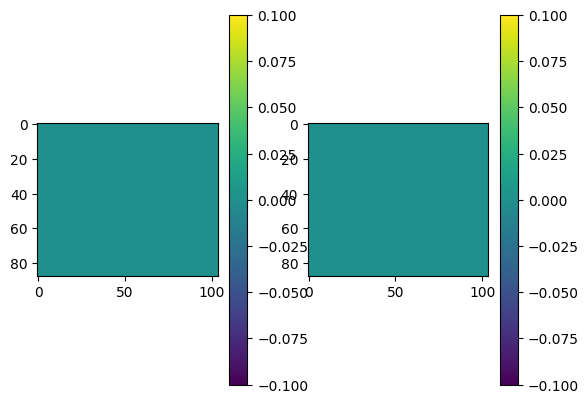

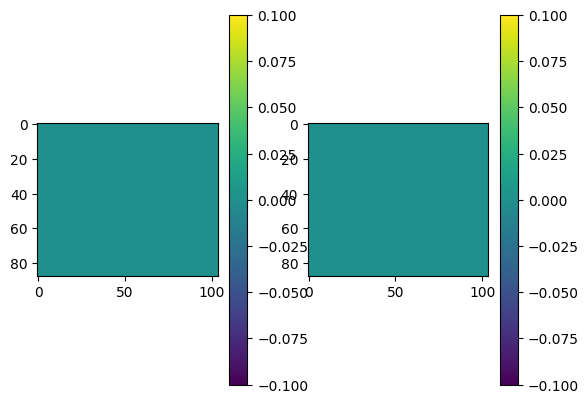

In [98]:
year = 2021

# Retrive a year long data
_start_date = datetime(year, 3, 1)
_end_date   = datetime(year + 1, 1, 1)


# Define Resources to loop over
resources_ = ['Demand', 'Solar', 'Wind']

# Get daylong data request
_delta = timedelta(days = 1)

# Defining the timezone
_utc = pytz.timezone('UTC')
_ptz = pytz.timezone('America/Los_Angeles')

# Define date in is corresponding timezone
_utc_date = _utc.localize(_start_date)

# Define holidays calendar
_CA_holidays = holidays.country_holidays('US', subdiv = 'CA')

all_CAISO_ac_ = []
all_CAISO_fc_ = []
all_NOAA_ac_  = []
all_NOAA_fc_  = []

time_pfz_ = []
time_utc_ = []

dt_prev = -8
flag    = False

# Loop over number of days
for i in range((_end_date - _start_date).days):
    # Get date in API request format
    time = f"{_utc_date.year:02}{_utc_date.month:02}{_utc_date.day:02}"
    print(time)
    # Check time difference between time zones
    _ptz_date = _utc_date.astimezone(_ptz)
    dt_new    = int(_ptz_date.utcoffset().total_seconds()/3600)
    # Rise flag if the number of hours is differe
    if dt_prev != dt_new: 
        flag = True
    
    else:
        # try:
        # Load CAISO Data
        CAISO_ac_ = []
        CAISO_fc_ = []
        # Loop Over type of resource
        for j in range(len(resources_)):
            resource = resources_[j]
            # Load resource file for a given data
            pickle_file_name = path_to_oac + f"{resource}_{time}.pkl"
            with open(pickle_file_name, 'rb') as _f:
                CAISO_ac_.append(pickle.load(_f).to_numpy())

        # Loop Over type of resource
        for j in range(len(resources_)):
            resource = resources_[j]
            # Load resource file for a given data
            pickle_file_name = path_to_ofc + f"{resource}_{time}.pkl"
            with open(pickle_file_name, 'rb') as _f:
                CAISO_fc_.append(pickle.load(_f).to_numpy())

        # Load Weather Data
        pickle_file_name = path_to_oac + f"Weather_{time}.pkl"
        with open(pickle_file_name, 'rb') as _f:
            NOAA_ac_ = pickle.load(_f)[:, 0, ...]
        # Load Weather Data
        pickle_file_name = path_to_ofc + f"Weather_{time}-00.pkl"
        with open(pickle_file_name, 'rb') as _f:
            NOAA_fc_ = pickle.load(_f)[0, ...][7:31, ...]
        all_CAISO_ac_.append(np.concatenate(CAISO_ac_, axis = 1)[:, 1:])
        all_CAISO_fc_.append(np.concatenate(CAISO_fc_, axis = 1)[:, 1:])
        all_NOAA_ac_.append(NOAA_ac_)
        all_NOAA_fc_.append(NOAA_fc_)

        time_pfz_.append(np.array([[_ptz_date.year, _ptz_date.month, _ptz_date.day, _ptz_date.timetuple().tm_yday, 
                                    (_ptz_date + timedelta(days = hour/24)).hour, 
                                    _ptz_date.weekday(), (_ptz_date.timetuple().tm_wday >= 5)*1, int(_ptz_date in _CA_holidays)] 
                                   for hour in range(24)]))
        time_utc_.append(np.array([[_utc_date.year, _utc_date.month, _utc_date.day, _utc_date.timetuple().tm_yday, 
                                    (_utc_date + timedelta(days = hour/24)).hour, 
                                    _utc_date.weekday(), (_utc_date.timetuple().tm_wday >= 5)*1, int(_utc_date in _CA_holidays)] 
                                   for hour in range(24)]))
        # except: 
        #     print('missing')
        #     flag = True
    
    # Generate a batch when rise flag and there is data
    if flag and (len(all_CAISO_fc_) > 2):
        print(dt_prev, dt_new)
        print(_utc_date, _ptz_date)
        all_CAISO_ac_ = np.concatenate(all_CAISO_ac_, axis = 0)[:dt_prev, ...][:-24 - dt_prev, ...]
        all_CAISO_fc_ = np.concatenate(all_CAISO_fc_, axis = 0)[:dt_prev, ...][:-24 - dt_prev, ...]
        all_NOAA_ac_  = np.concatenate(all_NOAA_ac_, axis = 0)[-dt_prev:, ...][:-24 - dt_prev, ...]
        all_NOAA_fc_  = np.concatenate(all_NOAA_fc_, axis = 0)[:-24, ...]

        GSI_         = np.concatenate((all_NOAA_fc_[1:, -1, :], np.zeros((1, all_NOAA_fc_.shape[-1]))), axis = 0)
        all_NOAA_fc_ = np.concatenate((all_NOAA_fc_[:, :-1, :], GSI_[:, np.newaxis, :]), axis = 1)

        time_pfz_ = np.concatenate(time_pfz_, axis = 0)[-dt_prev:, :][:-24 -dt_prev, ...]
        print(time_pfz_[0, :])
        print(time_pfz_[-1, :])

        time_utc_ = np.concatenate(time_utc_, axis = 0)[:dt_prev, ...][:-24 - dt_prev, ...]
        print(time_utc_[0, :])
        print(time_utc_[-1, :])
            
        all_CAISO_ac_ = []
        all_CAISO_fc_ = []
        all_NOAA_ac_  = []
        all_NOAA_fc_  = []

        time_pft_ = []
        
        break


    # Reset flag
    flag = False
        
    
    # Go to next date
    dt_prev = dt_new
    
    _utc_date += timedelta(days = 1)

In [9]:
year = 2020

forecasts = 0

# Retrive a year long data
_start_date = date(year, 1, 1)
_end_date   = date(year + 1, 1, 1)

# Define path to files
paths_ = [path_to_oac, path_to_oac, path_to_ofc][forecasts]

# Define Resources to loop over
resources_ = ['Demand', 'Solar', 'Wind']

# Get daylong data request
_delta = timedelta(days = 1)

# Loop over number of days
for i in range((_end_date - _start_date).days):

    # Get date in API request format
    time = f"{_start_date.year:02}{_start_date.month:02}{_start_date.day:02}"
    
    try:
        # Load CAISO Data
        data_prime_ = []
        
        # Loop Over type of resource
        for j in range(len(resources_)):
            resource = resources_[j]
            # Load resource file for a given data
            pickle_file_name = path + f"{resource}_{time}.pkl"
            with open(pickle_file_name, 'rb') as _f:
                data_prime_.append(pickle.load(_f))

        # Save Predictors and Covariates in the same set
        data_ = []
        data_.append(np.concatenate(data_prime_, axis = 1))
        
        # Load Weather Data
        pickle_file_name = path + f"Weather_{time}.pkl"
        with open(pickle_file_name, 'rb') as _f:
            data_.append(pickle.load(_f))
        
        # Save Data in LZMA compression format
        lzma_file_name = path + f"actual_{time}.xz"
        with lzma.open(lzma_file_name, "wb") as _f:
            pickle.dump(data_, _f)
            
    # Prite dates with missing files
    except:
        print('Missing: ', pickle_file_name)
        pass
    
    # Got to next day
    _start_date += _delta

Missing:  /Users/Guille/Desktop/caiso_power/output/actuals/Demand_20200101.pkl
Missing:  /Users/Guille/Desktop/caiso_power/output/actuals/Demand_20200102.pkl
Missing:  /Users/Guille/Desktop/caiso_power/output/actuals/Demand_20200103.pkl
Missing:  /Users/Guille/Desktop/caiso_power/output/actuals/Demand_20200104.pkl
Missing:  /Users/Guille/Desktop/caiso_power/output/actuals/Demand_20200105.pkl
Missing:  /Users/Guille/Desktop/caiso_power/output/actuals/Demand_20200106.pkl
Missing:  /Users/Guille/Desktop/caiso_power/output/actuals/Demand_20200107.pkl
Missing:  /Users/Guille/Desktop/caiso_power/output/actuals/Demand_20200108.pkl
Missing:  /Users/Guille/Desktop/caiso_power/output/actuals/Demand_20200109.pkl
Missing:  /Users/Guille/Desktop/caiso_power/output/actuals/Demand_20200110.pkl
Missing:  /Users/Guille/Desktop/caiso_power/output/actuals/Demand_20200111.pkl
Missing:  /Users/Guille/Desktop/caiso_power/output/actuals/Demand_20200112.pkl
Missing:  /Users/Guille/Desktop/caiso_power/output/a

# Synchronize NOAA and CAISO data

In [54]:
def _synchronize_NOAA_and_CAISO_data(X_, Y_, Z_):

    # Concatenate data in the batch
    X_p_ = np.concatenate(X_, axis = -1)
    Y_p_ = np.swapaxes(np.concatenate(Y_, axis = -1), 0, 1)
    Z_p_ = np.concatenate(Z_, axis = -1)
    print(X_p_.shape, Y_p_.shape, Z_p_.shape)

    N_hours = Y_p_.shape[1]
    # Reshape as a sequence of continues data
    X_pp_ = np.concatenate([X_p_[..., i] for i in range(X_p_.shape[-1])], axis = -1)
    Y_pp_ = np.concatenate([Y_p_[..., i] for i in range(Y_p_.shape[-1])], axis = -1)
    Z_pp_ = np.concatenate([np.array((Z_p_[0, i], Z_p_[1, i], Z_p_[2, i], j, Z_p_[3, i], Z_p_[4, i]))[..., np.newaxis] 
                            for i in range(Z_p_.shape[-1]) for j in range(N_hours)], axis = 1)
    print(X_pp_.shape, Y_pp_.shape, Z_pp_.shape)

    # synchronize data from different timezones
    X_ppp_ = X_pp_[..., -dt_new:]
    Y_ppp_ = Y_pp_[:, :dt_new]
    Z_ppp_ = Z_pp_[:, -dt_new:]
    print(X_ppp_.shape, Y_ppp_.shape, Z_ppp_.shape)


    # Remove remaining samples to have entire das
    N_samples = Y_ppp_.shape[-1]

    X_pppp_ = X_ppp_[..., :N_samples - (N_hours + dt_new)]
    Y_pppp_ = Y_ppp_[:, :N_samples - (N_hours + dt_new)]
    Z_pppp_ = Z_ppp_[:, :N_samples - (N_hours + dt_new)]
    print(X_pppp_.shape, Y_pppp_.shape, Z_pppp_.shape)
    
    # Reshape data back in days and day hours shape
    N_days = X_pppp_.shape[-1]//N_hours

    X_ppppp_ = []
    Y_ppppp_ = []
    Z_ppppp_ = []
    for i in range(N_days):
        j = i*N_hours
        k = (i + 1)*N_hours
        X_ppppp_.append(X_pppp_[..., j:k][..., np.newaxis])
        Y_ppppp_.append(Y_pppp_[..., j:k][..., np.newaxis])
        Z_ppppp_.append(Z_pppp_[..., j:k][..., np.newaxis])

    # Define data in matrix form
    X_ppppp_ = np.concatenate(X_ppppp_, axis = -1)
    Y_ppppp_ = np.concatenate(Y_ppppp_, axis = -1)
    Z_ppppp_ = np.concatenate(Z_ppppp_, axis = -1)
    print(X_ppppp_.shape, Y_ppppp_.shape, Z_ppppp_.shape)
    
    return [X_ppppp_, Y_ppppp_, Z_ppppp_]
           
# Save chunk of processed date in a blosc file
def _save_data_in_compressed_files(data_, path, year, N_max_samples_per_chunk = 80):
    
    def __save_compressed_file(data_, path, year, chunk):
        dat_file_name = r'{}/ac_{}_{}.dat'.format(path, year, chunk)
        with open(dat_file_name, "wb") as f:
            f.write(blosc.compress(pickle.dumps(data_)))

    # Loop over chuncks
    for i in range(len(data_)):
        # Check samples in the chunk
        N_samples = data_[i][0].shape[-1]
        # Check if several chunks are necessary
        N_chunks = int(N_samples / N_max_samples_per_chunk) + 1
        # Define number of necessary chunks
        if N_chunks > 1: N_samples = int(np.ceil(N_samples/N_chunks))
        # Save Chunks
        for j in range(N_chunks):
            # Define samples in the j-th chunks
            k = j*N_samples
            l = (j + 1)*N_samples
            data_p_ = [data_[i][0][..., k:l], data_[i][1][..., k:l], data_[i][2][..., k:l]]

            __save_compressed_file(data_p_, path_to_processed_data, year  = _ptz_date.year, 
                                                                    chunk = f"{i:01}-{j:01}")
            
# Remove the orginal files of the compressed files
def _remove_processed_files(_start_date, path, N_days):
    for day in range(N_days):
        time = f"{_start_date.year:02}{_start_date.month:02}{_start_date.day:02}"
        lzma_file_name = r'{}/ac_{}.xz'.format(path, time)
        try:
            print(lzma_file_name)
            #os.remove(lzma_file_name)
        except:
            continue
            
        _start_date += timedelta(days = 1)

path_to_processed_data = r'/Users/Guille/Desktop/caiso_power/output/processed_data'

year = 2020

# Retrive a year long data
_start_date = datetime(year, 1, 1)
_end_date   = datetime(year + 1, 1, 1)
N_days      = (_end_date - _start_date).days
# Defining the timezone
_utc = pytz.timezone('UTC')
_ptz = pytz.timezone('America/Los_Angeles')

# Define date in is corresponding timezone
_utc_date = _utc.localize(_start_date)
print(_utc_date)

# Define holidays calendar
_CA_holidays = holidays.country_holidays('US', subdiv = 'CA')
    
# Variables initialization
X_ = []
Y_ = []
Z_ = []
data_p_ = []
dt_prev = -8
flag    = False

# Loop over all possible days in a year
for day in range(N_days):
    # Check time difference between time zones
    _ptz_date = _utc_date.astimezone(_ptz)
    dt_new    = int(_ptz_date.utcoffset().total_seconds()/3600)

    # Rise flag if the number of hours is differe
    if dt_prev != dt_new: 
        flag = True

    # Rise flag if files does not exits
    try:
        time = f"{_ptz_date.year:02}{_ptz_date.month:02}{_ptz_date.day:02}"
        lzma_file_name = r'{}/ac_{}.xz'.format(path_to_processed_data, time)
        with lzma.open(lzma_file_name, "rb") as _f:
            data_ = pickle.load(_f)
        print(lzma_file_name)
  
        X_.append(data_[1][..., np.newaxis])
        Y_.append(data_[0][..., np.newaxis])
        Z_.append(np.array((_ptz_date.year, _ptz_date.month, _ptz_date.day, 
                            _ptz_date.weekday(), int(_ptz_date in _CA_holidays)))[..., np.newaxis])

    except:
        flag = True
            
    # Generate a batch when rise flag and there is data
    if flag and (len(X_) > 2):

        # synchronize data
        data_p_.append(_synchronize_NOAA_and_CAISO_data(X_, Y_, Z_))
        
        # Initilize storage variables for next batch
        Y_ = []
        X_ = []
        Z_ = []
        
    # Reset flag
    flag = False
        
    # Go to next date
    dt_prev    = dt_new
    _utc_date += timedelta(days = 1)
        
_save_data_in_compressed_files(data_p_, path_to_processed_data, year = _ptz_date.year)

_remove_processed_files(_start_date, path_to_processed_data, N_days)

2020-01-01 00:00:00+00:00
/Users/Guille/Desktop/caiso_power/output/processed_data/ac_20200102.xz
/Users/Guille/Desktop/caiso_power/output/processed_data/ac_20200103.xz
/Users/Guille/Desktop/caiso_power/output/processed_data/ac_20200104.xz
/Users/Guille/Desktop/caiso_power/output/processed_data/ac_20200105.xz
/Users/Guille/Desktop/caiso_power/output/processed_data/ac_20200106.xz
/Users/Guille/Desktop/caiso_power/output/processed_data/ac_20200107.xz
/Users/Guille/Desktop/caiso_power/output/processed_data/ac_20200108.xz
/Users/Guille/Desktop/caiso_power/output/processed_data/ac_20200109.xz
/Users/Guille/Desktop/caiso_power/output/processed_data/ac_20200110.xz
/Users/Guille/Desktop/caiso_power/output/processed_data/ac_20200111.xz
/Users/Guille/Desktop/caiso_power/output/processed_data/ac_20200112.xz
/Users/Guille/Desktop/caiso_power/output/processed_data/ac_20200113.xz
/Users/Guille/Desktop/caiso_power/output/processed_data/ac_20200114.xz
/Users/Guille/Desktop/caiso_power/output/processed_

# Load Data and Form Dataset

(14, 9152, 24, 66) (20, 24, 66) (6, 24, 66)
(14, 9152, 24, 2) (20, 24, 2) (6, 24, 2)
(14, 9152, 24, 16) (20, 24, 16) (6, 24, 16)
(14, 9152, 24, 76) (22, 24, 76) (6, 24, 76)
(14, 9152, 24, 137) (22, 24, 137) (6, 24, 137)
(14, 9152, 24, 9) (22, 24, 9) (6, 24, 9)
6


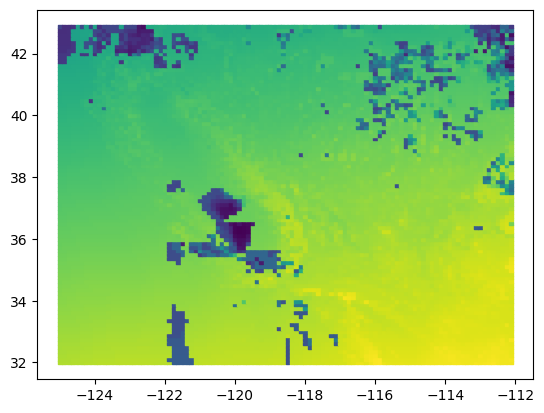

/Users/Guille/Desktop/caiso_power/output/auxiliary/USland_0.125_(-125,-112)_(32,43).pkl


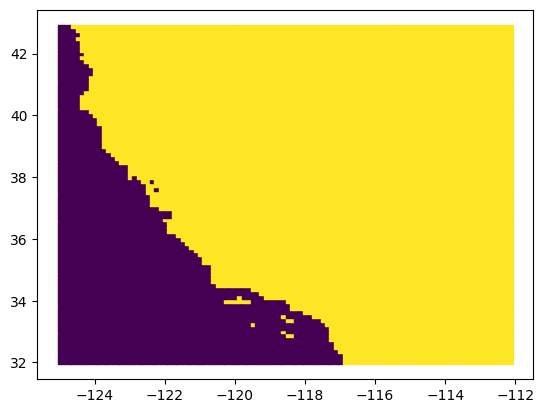

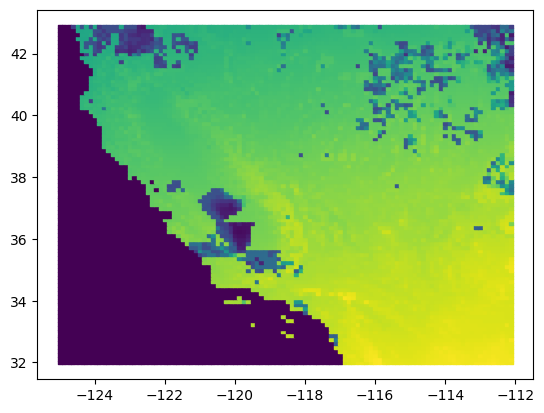

In [25]:
# Load data in a compressed file
def _load_data_in_chunks(years_, path):
    
    def __load_data_in_compressed_file(file):
        with open(file, "rb") as f:
            data_ = f.read()
        return pickle.loads(blosc.decompress(data_)) 

    data_ = []
    
    # Loop over processed years
    for year in years_:
        # Find processed data from that year
        files_ = glob.glob(path + "ac_{}_*".format(year))
        # Define the maximum feasible number of chunks
        N_min_chunks = len(files_)
        # Loop over all possible chunks
        for i in range(N_min_chunks):
            X_, Y_, Z_ = [], [], []
            for j in range(N_min_chunks):
                # Load data if extis
                try:
                    file_name = path + "ac_{}_{}-{}.dat".format(year, i, j)
                    data_p_   = __load_data_in_compressed_file(file_name)
                    X_.append(data_p_[0])
                    Y_.append(data_p_[1])
                    Z_.append(data_p_[2])
                except: 
                    continue
            # Concatenate data if files existed
            if len(X_) > 0:
                X_ = np.concatenate(X_, axis = -1)
                Y_ = np.concatenate(Y_, axis = -1)
                Z_ = np.concatenate(Z_, axis = -1)
                print(X_.shape, Y_.shape, Z_.shape)

                data_.append([X_, Y_, Z_])
        
    return data_

data_ = _load_data_in_chunks([2020], path_to_odp)
print(len(data_))

plt.figure() 
plt.scatter(W_ref_[:, 0], W_ref_[:, 1], c      = data_[0][0][1, :, 12, 0], 
                                        s      = 7.5, 
                                        marker = 's')
plt.show()

# Compose saving name
file_name = path_to_oax + 'USland_{}_({},{})_({},{}).pkl'.format(delta, lon_min, lon_max, lat_min, lat_max)
with open(file_name, 'rb') as _f:
    i_ = pickle.load(_f)
print(file_name)


plt.figure() 
plt.scatter(W_ref_[:, 0], W_ref_[:, 1], c      = i_, 
                                        s      = 7.5, 
                                        marker = 's')
plt.show()


plt.figure() 
plt.scatter(W_ref_[:, 0], W_ref_[:, 1], c      = i_ * data_[0][0][1, :, 12, 0], 
                                        s      = 7.5, 
                                        marker = 's')
plt.show()

               NAME  Id                                           geometry
0              BANC   0  MULTIPOLYGON (((-137060.977 -20577.830, -13688...
1            CALISO   0  MULTIPOLYGON (((462257.252 -497407.760, 463725...
2               IID   0  POLYGON ((462362.442 -497410.335, 460826.878 -...
3             LADWP   0  MULTIPOLYGON (((155513.796 -60191.108, 156290....
4         NV Energy   0  POLYGON ((-107.678 179976.721, -109.123 179188...
5               TID   0  MULTIPOLYGON (((-49324.923 -90615.523, -48079....
6              WALC   0  MULTIPOLYGON (((498596.693 -497179.374, 495449...
7            CALISO   0  POLYGON ((-254205.250 270945.288, -254395.333 ...
8  PacificCorp West   0  POLYGON ((-193220.045 445064.081, -192189.846 ...


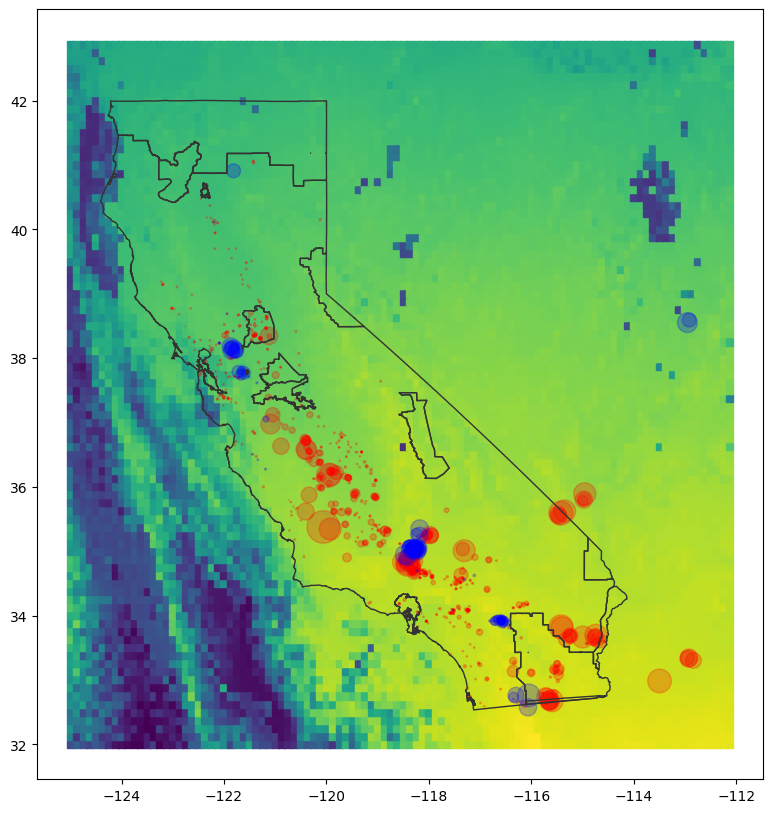

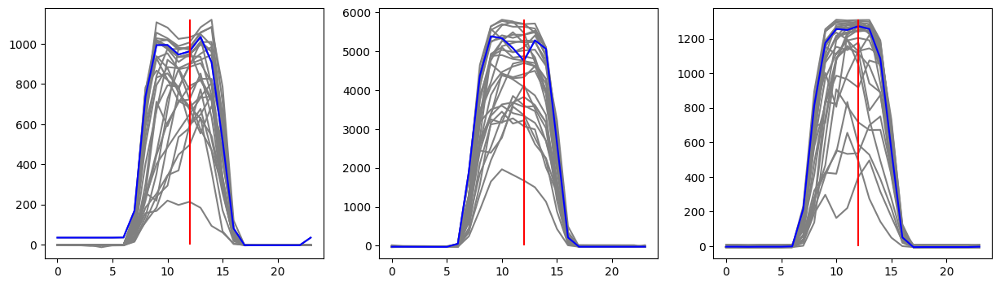

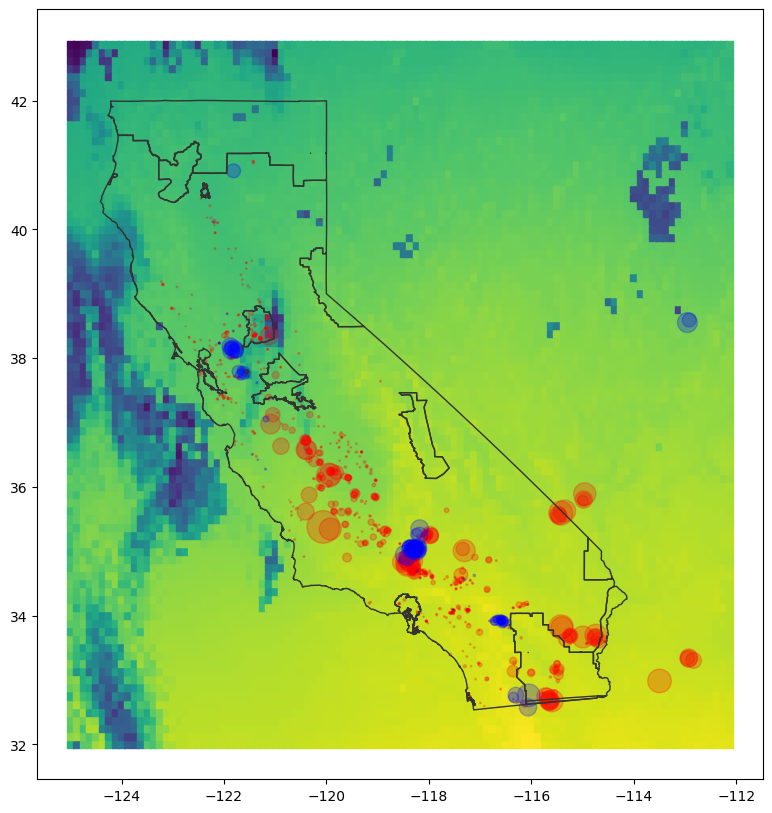

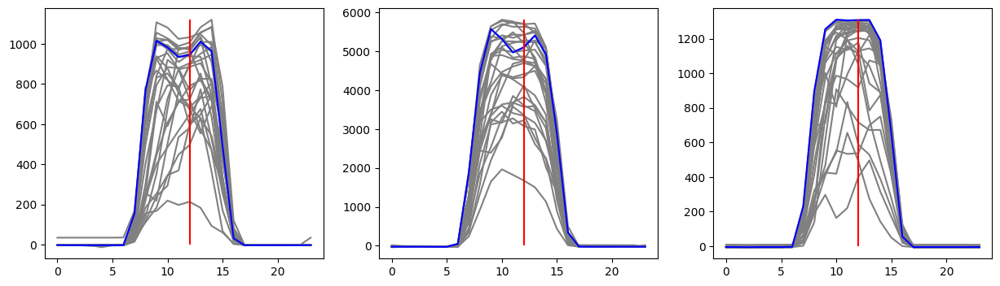

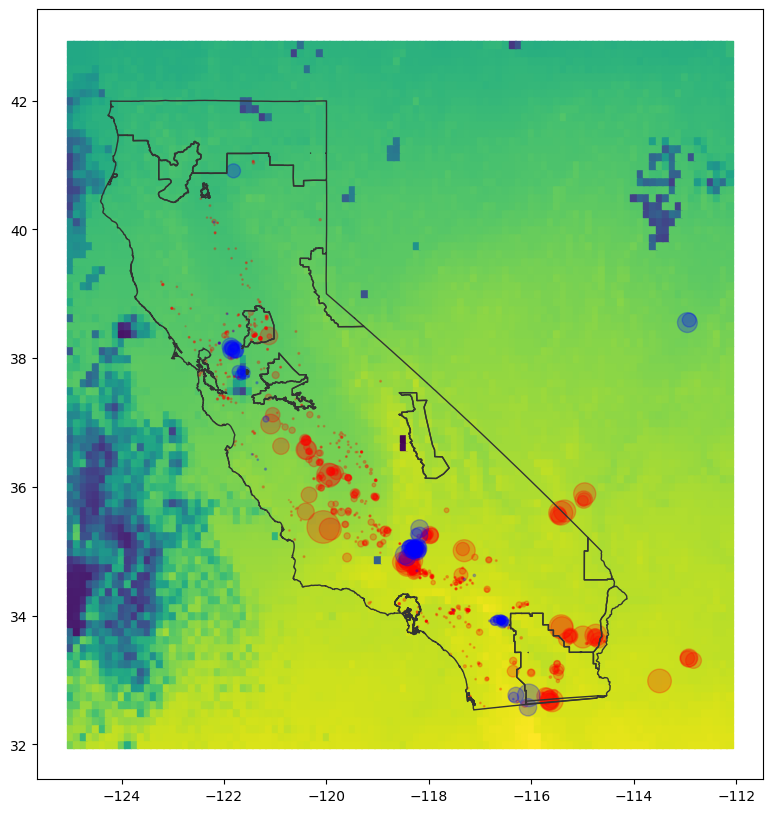

...

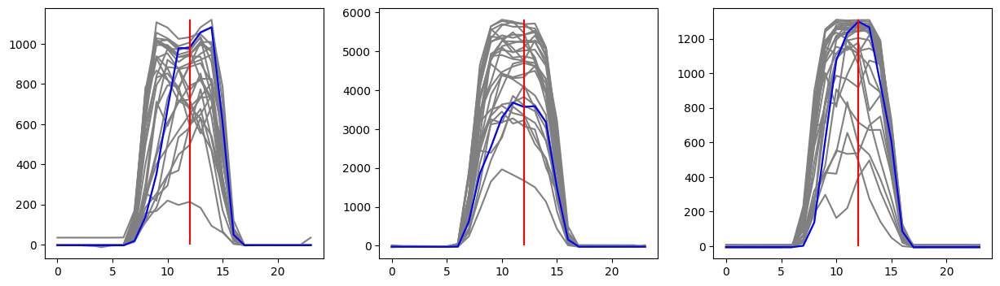

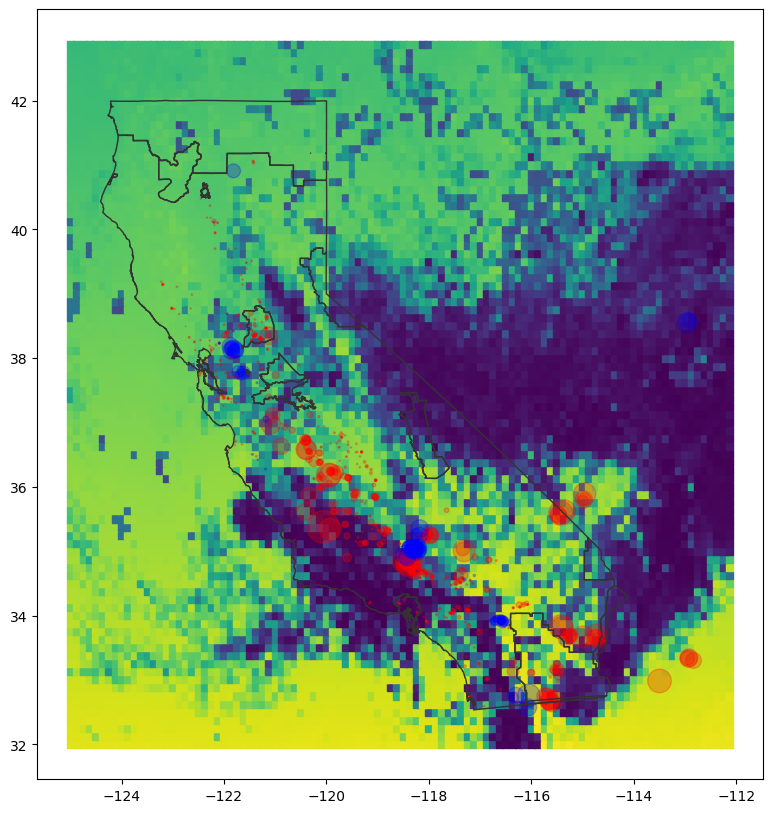

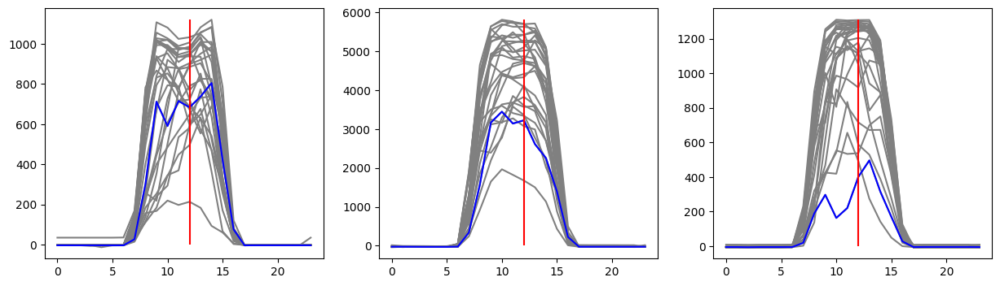

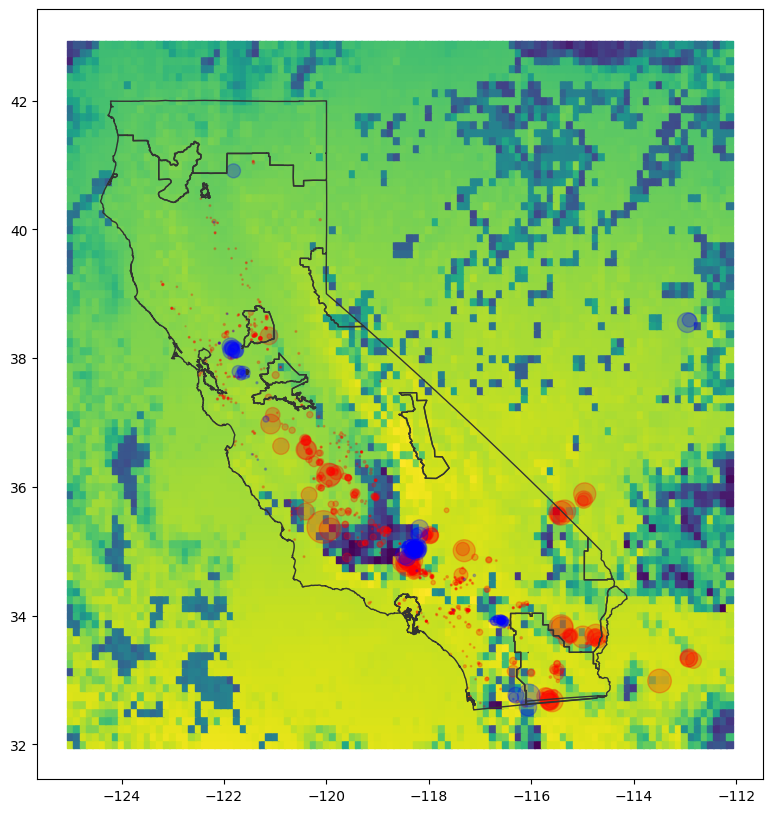

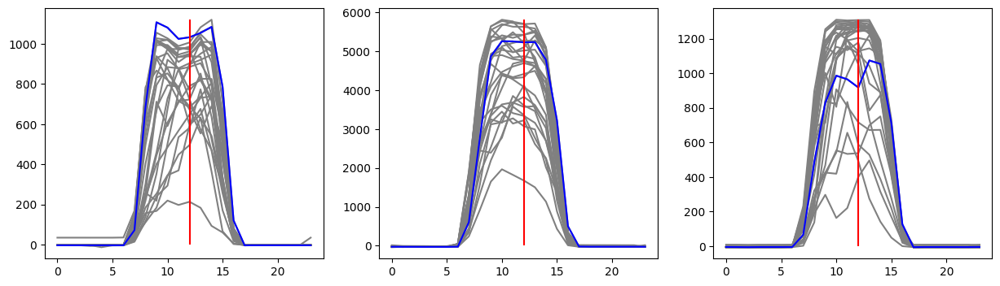

In [311]:
_CAISO = gpd.read_file(path_to_data + r"maps/CAISO/Balancing_Authority_Areas_in_CA.shp")
print(_CAISO)


i_hour = 12

for i in range(28):

    fig, ax = plt.subplots(1, figsize = (12.5, 10))

    ax.scatter(W_ref_[:, 0], W_ref_[:, 1], c = X_ppppp_[1, ..., i_hour, i], s = 26, marker = 's')
    
    ax.scatter(S_[:, 0], S_[:, 1], c     = 'r', 
                                   s     = S_[:, 2], 
                                   alpha = .25)
    ax.scatter(W_[:, 0], W_[:, 1], c     = 'b', 
                                   s     = W_[:, 2], 
                                   alpha = .25)
    
    _CAISO.to_crs("EPSG:4326").plot(ax        = ax, 
                                linewidth = 1., 
                                edgecolor = '0.2', 
                                color     = 'None', 
                                facecolor = 'none')
    plt.show()
        
    plt.figure(figsize = (15, 4))
    plt.subplot(131)
    plt.plot(Y_ppppp_[17, :, :], 'gray')
    plt.plot(Y_ppppp_[17, :, i], 'b')
    plt.vlines(i_hour, 0., Y_ppppp_[17, :, :].max(), 'r')
    
    plt.subplot(132)
    plt.plot(Y_ppppp_[18, :, :], 'gray')
    plt.plot(Y_ppppp_[18, :, i], 'b')
    plt.vlines(i_hour, 0., Y_ppppp_[18, :, :].max(), 'r')

    plt.subplot(133)
    plt.plot(Y_ppppp_[19, :, :], 'gray')
    plt.plot(Y_ppppp_[19, :, i], 'b')
    plt.vlines(i_hour, 0., Y_ppppp_[19, :, :].max(), 'r')
    plt.show()




# CAISO Map 

               NAME  Id                                           geometry
0              BANC   0  MULTIPOLYGON (((-137060.977 -20577.830, -13688...
1            CALISO   0  MULTIPOLYGON (((462257.252 -497407.760, 463725...
2               IID   0  POLYGON ((462362.442 -497410.335, 460826.878 -...
3             LADWP   0  MULTIPOLYGON (((155513.796 -60191.108, 156290....
4         NV Energy   0  POLYGON ((-107.678 179976.721, -109.123 179188...
5               TID   0  MULTIPOLYGON (((-49324.923 -90615.523, -48079....
6              WALC   0  MULTIPOLYGON (((498596.693 -497179.374, 495449...
7            CALISO   0  POLYGON ((-254205.250 270945.288, -254395.333 ...
8  PacificCorp West   0  POLYGON ((-193220.045 445064.081, -192189.846 ...
     NAME  Id                                           geometry
1  CALISO   0  MULTIPOLYGON (((462257.252 -497407.760, 463725...
7  CALISO   0  POLYGON ((-254205.250 270945.288, -254395.333 ...


<AxesSubplot: >

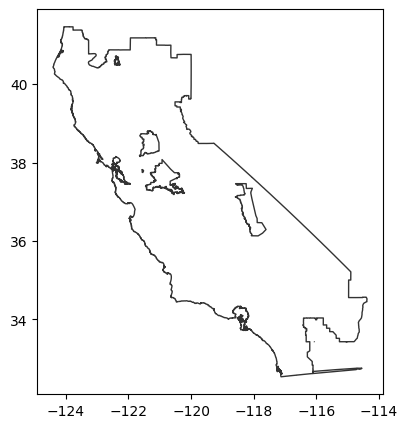

In [2]:
_CAISO = gpd.read_file(path_to_data + r'maps/CAISO/Balancing_Authority_Areas_in_CA.shp')
print(_CAISO)

_CAISO_prime_ = _CAISO.iloc[[1, 7,]]
print(_CAISO_prime_)
            
fig, ax = plt.subplots(1, figsize = (5, 5))
_CAISO_prime_.to_crs("EPSG:4326").plot(ax        = ax, 
                                       linewidth = 1., 
                                       edgecolor = '0.2', 
                                       color     = 'None', 
                                       facecolor = 'none')

## NOAA Compressed Database (it does not provide forecasted radiaiton)

This might not be of any use...

In [174]:
Guillermo Terren Serrano# Load Demand URL data
day   = '01'
month = '05'
year  = '2022'
UTC   = '01'

version = ['fcst', 'anl'][0]

date = year + month + day
print(date)

database_ = zarr.open(s3fs.S3Map("s3://hrrrzarr/sfc/{}/{}_{}z_{}.zarr".format(date, date, UTC, version), s3 = s3fs.S3FileSystem(anon = True)))

# RH_    = database_["2m_above_ground/RH/2m_above_ground/RH"][...]
# T_dew_ = database_["2m_above_ground/DPT/2m_above_ground/DPT"][...]
# T_     = database_["2m_above_ground/TMP/2m_above_ground/TMP"][...]
# print(RH_.shape, T_dew_.shape, T_.shape)

P_  = database_["surface/APCP/surface/APCP"][...]
PR_ = database_["surface/PRATE/surface/PRATE"][...]
print(P_.shape, PR_.shape)

# ULWRF_ = database_["surface/ULWRF/surface/ULWRF"][...]
# USWRF_ = database_["surface/USWRF/surface/USWRF"][...]
# DLWRF_ = database_["surface/DLWRF/surface/DLWRF"][...]
# DSWRF_ = database_["surface/DSWRF/surface/DSWRF"][...]
# print(ULWRF_.shape, USWRF_.shape, DLWRF_.shape, DSWRF_.shape)

# U_10_ = database_["10m_above_ground/UGRD/10m_above_ground/UGRD"][...]
# V_10_ = database_["10m_above_ground/VGRD/10m_above_ground/VGRD"][...]
# U_80_ = database_["80m_above_ground/UGRD/80m_above_ground/UGRD"][...]
# V_80_ = database_["80m_above_ground/VGRD/80m_above_ground/VGRD"][...]
# print(U_10_.shape, V_10_.shape, U_80_.shape, V_80_.shape)

# database_ = zarr.open(s3fs.S3Map("s3://hrrrzarr", s3 = s3fs.S3FileSystem(anon = True)))

# lat_ = database_["grid/HRRR_chunk_index.zarr"]["latitude"][...]
# lon_ = database_["grid/HRRR_chunk_index.zarr"]["longitude"][...]
# print(lat_.shape, lon_.shape)

        

20220501


KeyError: 'surface/APCP/surface/APCP'

[-10000.]


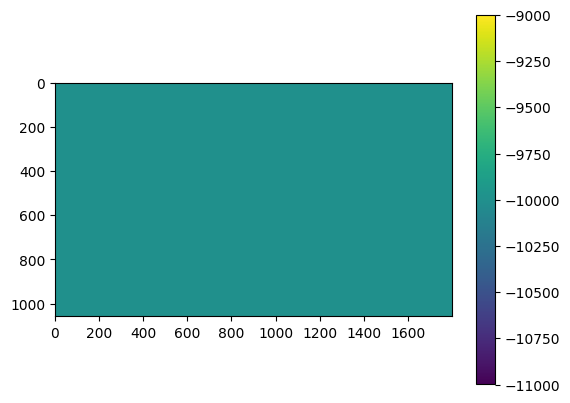

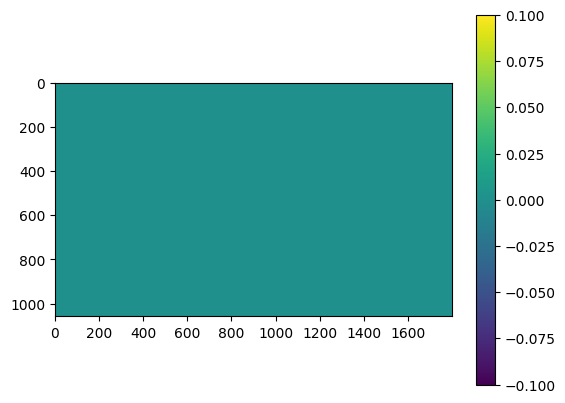

/var/folders/0c/ffx2kgyn7xq4krqrpsv67l3m0000gn/T/ipykernel_7343/2282587244.py:16: RuntimeWarning: invalid value encountered in log
  plt.imshow(np.log(PR_))


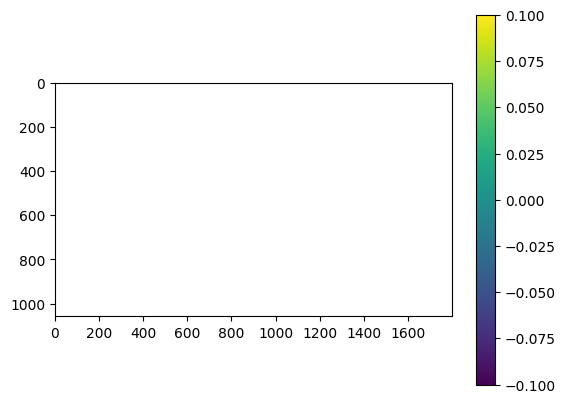

In [169]:
Terren Serranoprint(np.unique(PR_))

plt.figure()
plt.imshow(PR_)
plt.colorbar()
plt.show()

plt.figure()
plt.imshow(np.exp(PR_))
plt.colorbar()
plt.show()

plt.figure()
plt.imshow(np.log(PR_))
plt.colorbar()
plt.show()

<AxesSubplot:>

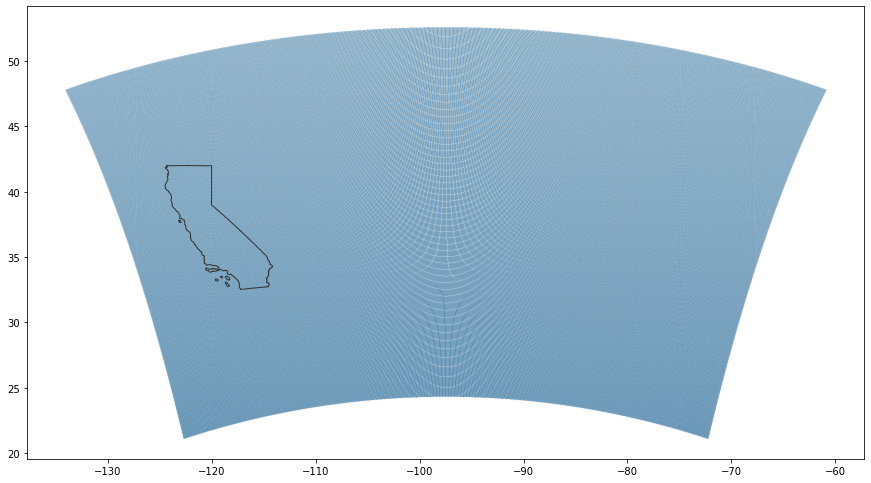

In [54]:
_CA = gpd.read_file('/Users/Guille/Desktop/caiso_power/data/maps/CA_State_TIGER2016.shp')

fig, ax = plt.subplots(1, figsize = (15, 15))

ax.scatter(lon_.flatten(), lat_.flatten(), s = .0005)
_CA.to_crs("EPSG:4326").plot(ax = ax, linewidth = 1., edgecolor = '0.2', color = 'None', facecolor = 'none')

_CA_prime_ = _CA['geometry'].to_crs("EPSG:4326")

M, N = lon_.shape
I_   = np.zeros((M, N))

for i in range(M):
    for j in range(N):    
        if _CA_prime_.contains(Point(lon_[i, j], lat_[i, j]))[0]: I_[i, j] = 1.
            
fig, ax = plt.subplots(1, figsize = (20, 20))
ax.scatter(lon_.flatten(), lat_.flatten(), c = I_.flatten(), s = .0005)
_CA.to_crs("EPSG:4326").plot(ax = ax, linewidth = 1., edgecolor = '0.2', color = 'None', facecolor = 'none')

lon_prime_ = lon_[I_ == 1.]
lat_prime_ = lat_[I_ == 1.]
print(lon_prime_.shape, lat_prime_.shape)

fig, ax = plt.subplots(1, figsize = (20, 20))
_CA.to_crs("EPSG:4326").plot(ax = ax, linewidth = 1., edgecolor = '0.2', color = 'None', facecolor = 'none')
plt.scatter(lon_prime_, lat_prime_, s = 0.1)

In [69]:
files_ = glob.glob(path_to_oac + r"RTPD_*")

for files in files_:
    print(files)

    
    with open(files, 'rb') as _f:
        A_ = pickle.load(_f)
        
    for i in range(24):
        
        print(A_[i].shape)

/Users/Guille/Desktop/caiso_power/output/actuals/RTPD_20200228.pkl
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
(1633, 5)
/Users/Guille/Desktop/caiso_power/output/actuals/RTPD_20200214.pkl
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
(1629, 5)
/Users/Guille/Desktop/caiso_power/output/actuals/RTPD_20200406.pkl
(1833, 5)
(1833, 5)
(1833, 5)
(1833, 5)
(1833, 5)
(1833, 5)
(1833, 5)
(1835, 5)
(1835, 5)
(1835, 5)
(1835, 5)
(1835, 5)
(1835, 5)
(1835, 5)
(1835, 5)
(1835, 5)
(1835, 5)
(1835, 5)
(1835, 5)
(1835, 5)
(1835, 5)
(1835, 5)
(1835, 5)
(1835, 5)
/Users/Guille/Desktop/caiso_power/output/actuals/RTPD_20200412.pkl
(1835, 5)
(1

In [72]:
print(len(A_))
print(A_[0].shape)

print(A_[0])

24
(1627, 5)
[['AFPR_1_TOT_GEN-APND' 10.54014 12.63001 16.66579 32.65507]
 ['AGRICO_6_PL3N5-APND' 10.9328 13.24796 27.48271 50.15429]
 ['AGRICO_7_UNIT-APND' 10.9328 13.24796 27.48271 50.15429]
 ...
 ['WP_2_WPCC5MSG-APND' 9.93352 12.08255 16.28433 32.36506]
 ['WSH_1_WESTSIDEHYD-APND' 10.73669 12.83193 17.25036 33.32749]
 ['YALE_7_UNITS-APND' 10.3689 12.39531 16.62411 32.10057]]


In [76]:

for i in range(A_[0].shape[0]):
    node_name = A_[0][i, 0]
    if node_name == search:
        print(node_name)

In [79]:
import csv

nodes_ = A_[0][:, 0]
print(len(nodes_))

_f = open(path_to_oac + r"nodes.csv", 'w')

# create the csv writer
writer = csv.writer(_f)

# write a row to the csv file
writer.writerow(nodes_)

# close the file
_f.close()

1627
